In [ ]:
# Install required libs

### please update Albumentations to version>=0.3.0 for `Lambda` transform support
#!pip install -U albumentations>=0.3.0 --user

In [1]:
!pip install -U git+https://github.com/albu/albumentations --no-cache-dir

  Cloning https://github.com/albu/albumentations to /tmp/pip-req-build-yu30c6au
  Running command git clone -q https://github.com/albu/albumentations /tmp/pip-req-build-yu30c6au
     |████████████████████████████████| 37.1 MB 1.2 MB/s 
  Created wheel for albumentations: filename=albumentations-1.0.3-py3-none-any.whl size=100279 sha256=ce2d1f1f082e9a41d06cc7ac662268e707a8e64abbbd7c95cc7e4ee71811a06f
  Stored in directory: /tmp/pip-ephem-wheel-cache-0t9zsbgp/wheels/63/11/1a/c77caf3ae9b9b6d57b3ee5e6a41a50f3bc12c66a70f6b90bf0
Successfully built albumentations
  Attempting uninstall: albumentations
    Found existing installation: albumentations 0.1.12
    Uninstalling albumentations-0.1.12:
      Successfully uninstalled albumentations-0.1.12


In [2]:
!pip install -U segmentation-models

     |████████████████████████████████| 50 kB 7.5 MB/s 


In [3]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow.keras as keras
from skimage import io, transform
import tensorflow as tf
import tensorflow.keras.backend as K


In [4]:
from google.colab import drive 
drive.mount("/content/drive") 

Mounted at /content/drive


In [11]:
DATA_DIR = '/content/drive/MyDrive/MS_Project/'
x_train_dir = os.path.join(DATA_DIR, 'Dataset/Train/frames')
y_train_dir = os.path.join(DATA_DIR, 'Dataset/Train/Masks')

x_valid_dir = os.path.join(DATA_DIR, 'Dataset/Val/frames')
y_valid_dir = os.path.join(DATA_DIR, 'Dataset/Val/masks')

x_test_dir = os.path.join(DATA_DIR, 'Dataset/Test/frames')
y_test_dir = os.path.join(DATA_DIR, 'Dataset/Test/Masks')

In [12]:
path = os.path.join(DATA_DIR, 'Test/Output_samples/VGG_sample.png')

In [13]:
# helper function for data visualization
def visualize(save=False, **images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
        if save:
            plt.savefig(path)
    plt.show()
    
# helper function for data visualization    
def denormalize(x):
    """Scale image to range 0..1 for correct plot"""
    x_max = np.percentile(x, 98)
    x_min = np.percentile(x, 2)    
    x = (x - x_min) / (x_max - x_min)
    x = x.clip(0, 1)
    return x

In [14]:
# classes for data loading and preprocessing
class Dataset:
    """CamVid Dataset. Read images, apply augmentation and preprocessing transformations.
    
    Args:
        images_dir (str): path to images folder
        masks_dir (str): path to segmentation masks folder
        class_values (list): values of classes to extract from segmentation mask
        augmentation (albumentations.Compose): data transfromation pipeline 
            (e.g. flip, scale, etc.)
        preprocessing (albumentations.Compose): data preprocessing 
            (e.g. noralization, shape manipulation, etc.)
    
    """
    
    CLASSES = ['Pitch']
    
    def __init__(
            self, 
            images_dir, 
            masks_dir, 
            classes=None, 
            augmentation=None, 
            preprocessing=None,
    ):
        self.ids = os.listdir(images_dir)
        self.images_fps = [os.path.join(images_dir, image_id) for image_id in self.ids]
        self.masks_fps = [os.path.join(masks_dir, image_id) for image_id in self.ids]
        
        
        self.augmentation = augmentation
        self.preprocessing = preprocessing
    
    def __getitem__(self, i):
        
        # read data
        image = cv2.imread(self.images_fps[i])
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(self.masks_fps[i], 0)
        

        image = transform.resize(image, (640, 640))
        mask = transform.resize(mask, (640, 640))
        
        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        # apply preprocessing
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
            
        return image, mask
        
    def __len__(self):
        return len(self.ids)
    
    
class Dataloder(keras.utils.Sequence):
    """Load data from dataset and form batches
    
    Args:
        dataset: instance of Dataset class for image loading and preprocessing.
        batch_size: Integet number of images in batch.
        shuffle: Boolean, if `True` shuffle image indexes each epoch.
    """
    
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

        self.on_epoch_end()

    def __getitem__(self, i):
        
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])
        
        # transpose list of lists
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]
        
        return tuple(batch)
    
    def __len__(self):
        """Denotes the number of batches per epoch"""
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        """Callback function to shuffle indexes each epoch"""
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

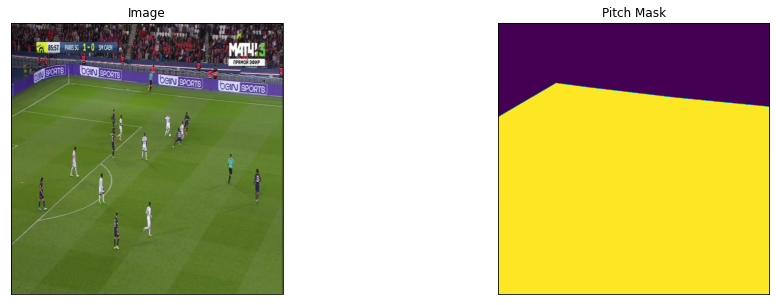

In [15]:
# Lets look at data we have
dataset = Dataset(x_train_dir, y_train_dir, classes=['Pitch'])

image, mask = dataset[5] # get some sample
visualize(
    image=image, 
    pitch_mask=mask.squeeze(),
)

In [16]:
import albumentations as A

In [17]:
def round_clip_0_1(x, **kwargs):
    return x.round().clip(0, 1)

# define heavy augmentations
def get_training_augmentation():
    train_transform = [

        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),

        A.ShiftScaleRotate(scale_limit=0.5, rotate_limit=0, shift_limit=0.1, p=1, border_mode=0),
    ]
    return A.Compose(train_transform)


def get_validation_augmentation():
    """Add paddings to make image shape divisible by 32"""
    test_transform = [
        A.PadIfNeeded(640, 640)
    ]
    return A.Compose(test_transform)

def get_preprocessing(preprocessing_fn):
    """Construct preprocessing transform
    
    Args:
        preprocessing_fn (callbale): data normalization function 
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose
    
    """
    
    _transform = [
        A.Lambda(image=preprocessing_fn),
    ]
    return A.Compose(_transform)

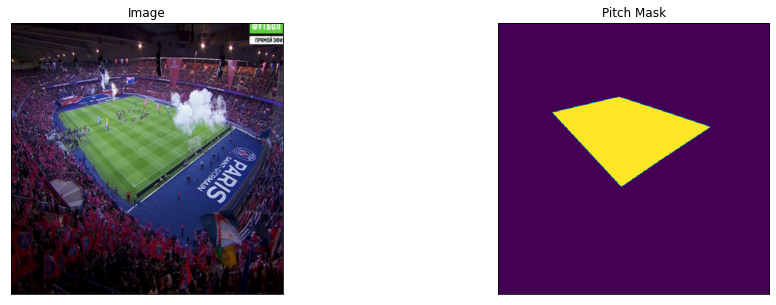

In [18]:
# Lets look at augmented data we have
dataset = Dataset(x_train_dir, y_train_dir, classes=['Pitch'], augmentation=get_training_augmentation())

image, mask = dataset[12] # get some sample
visualize(
    image=image, 
    Pitch_mask=mask.squeeze(),
)

In [19]:
import segmentation_models as sm
sm.set_framework('tf.keras')

sm.framework()

Segmentation Models: using `keras` framework.


'tf.keras'

In [20]:
BACKBONE = 'vgg16'
BATCH_SIZE = 10
CLASSES = ['Pitch']
LR = 0.0001
EPOCHS = 50

preprocess_input = sm.get_preprocessing(BACKBONE)

In [21]:
# define network parameters
n_classes = 1 
activation = 'sigmoid'



In [22]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        JaccardLoss = sm.losses.JaccardLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = JaccardLoss
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
58900480/58889256 [==============================] - 1s 0us/step
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU

In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_Vgg_JL__b10_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, min_delta=1e-4, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=20,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
valid_dataloader[0][0].shape
valid_dataloader[0][1].shape 

(1, 640, 640)

In [ ]:
len(valid_dataloader)

149

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
167/167 [==============================] - 2368s 14s/step - loss: 0.7702 - iou_score: 0.2732 - f1-score: 0.4288 - false_negatives: 47590148.0000 - false_positives: 14451607.0000 - true_negatives: 290847840.0000 - true_positives: 331142592.0000 - val_loss: 0.9997 - val_iou_score: 0.0067 - val_f1-score: 0.0067 - val_false_negatives: 45402252.0000 - val_false_positives: 11.0000 - val_true_negatives: 15628120.0000 - val_true_positives: 4.0000
Epoch 2/50
167/167 [==============================] - 410s 2s/step - loss: 0.7329 - iou_score: 0.2809 - f1-score: 0.4384 - false_negatives: 38863496.0000 - false_positives: 8562578.0000 - true_negatives: 299616608.0000 - true_positives: 336989408.0000 - val_loss: 0.9999 - val_iou_score: 0.0067 - val_f1-score: 0.0067 - val_false_negatives: 45402268.0000 - val_false_positives: 0.0000e+00 - val_true_negatives: 15628131.0000 - val_true_positives: 0.0000e+00
Epoch 3/50
167/167 [==============================] - 415s 2s/step - loss: 0.7267 - iou_

# Model with JL

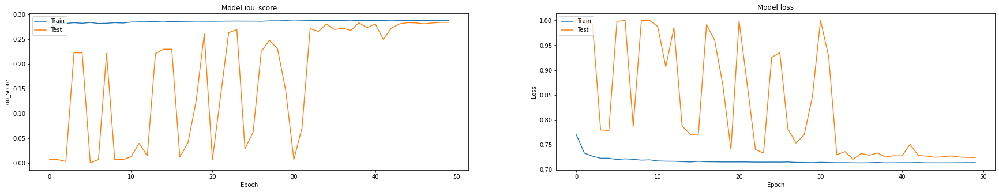

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [23]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [24]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_Vgg_JL__b10_IOU0.2836.h5')

In [ ]:
scores = model.evaluate(test_dataloader)

print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print('{:.5}'.format(value) )

169/169 [==============================] - 237s 1s/step - loss: 0.7178 - iou_score: 0.2887 - f1-score: 0.4447 - false_negatives: 3030376.0000 - false_positives: 543202.0000 - true_negatives: 19560400.0000 - true_positives: 46088416.0000
Loss: 0.71781
0.28866
0.44468
3.0304e+06
5.432e+05
1.956e+07
4.6088e+07


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 0.71781
IOU:0.28866
F1 Score:0.44468
FN:3030376.0
FP:543202.0
TN:19560400.0
TP:46088416.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')


SP:0.97298


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'Sensitivity:{Sensitivity:.5}')

Sensitivity:0.93831


In [25]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

In [26]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(155,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(save=False,
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

Output hidden; open in https://colab.research.google.com to view.

In [27]:
BATCH_SIZE = 12

In [28]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        JaccardLoss = sm.losses.JaccardLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = JaccardLoss
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_Vgg_JL__b12_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, min_delta=1e-4, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=20,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
139/139 [==============================] - 3128s 22s/step - loss: 0.7903 - iou_score: 0.2476 - f1-score: 0.3951 - false_negatives_1: 19526184.0000 - false_positives_1: 81586088.0000 - true_negatives_1: 227713504.0000 - true_positives_1: 354387168.0000 - val_loss: 0.9911 - val_iou_score: 0.0094 - val_f1-score: 0.0186 - val_false_negatives_1: 44960024.0000 - val_false_positives_1: 216704.0000 - val_true_negatives_1: 15411362.0000 - val_true_positives_1: 442304.0000
Epoch 2/50
139/139 [==============================] - 425s 3s/step - loss: 0.7391 - iou_score: 0.2806 - f1-score: 0.4382 - false_negatives_1: 29898930.0000 - false_positives_1: 11692829.0000 - true_negatives_1: 298263008.0000 - true_positives_1: 343358048.0000 - val_loss: 0.7819 - val_iou_score: 0.2269 - val_f1-score: 0.3672 - val_false_negatives_1: 1861234.0000 - val_false_positives_1: 12865244.0000 - val_true_negatives_1: 2762822.0000 - val_true_positives_1: 43541092.0000
Epoch 3/50
139/139 [======================

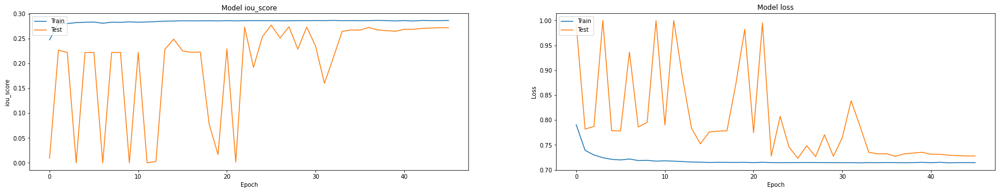

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [29]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [30]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_Vgg_JL__b12_IOU0.2772.h5')

In [ ]:
scores = model.evaluate_generator(test_dataloader)

print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print(": {:.5}".format(value))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


Loss: 0.7209
: 0.27954
: 0.43465
: 2.469e+06
: 1.4631e+06
: 1.8641e+07
: 4.665e+07


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 0.7209
IOU:0.27954
F1 Score:0.43465
FN:2469016.0
FP:1463092.0
TN:18640508.0
TP:46649784.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.92722


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'Sensitivity:{Sensitivity:.5}')

Sensitivity:0.94973


In [31]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

In [32]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(155,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

Output hidden; open in https://colab.research.google.com to view.

# DL+FL

In [ ]:
BATCH_SIZE = 10

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        total_loss = dice_loss + (1 * focal_loss)
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_Vgg_DL_FL_b10_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, min_delta=1e-4, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=20,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
167/167 [==============================] - 438s 3s/step - loss: 0.7487 - iou_score: 0.2095 - f1-score: 0.3358 - false_negatives_2: 180695920.0000 - false_positives_2: 4406204.0000 - true_negatives_2: 298980064.0000 - true_positives_2: 199949888.0000 - val_loss: 1.8609 - val_iou_score: 3.0151e-06 - val_f1-score: 6.0132e-06 - val_false_negatives_2: 45402196.0000 - val_false_positives_2: 340.0000 - val_true_negatives_2: 15627726.0000 - val_true_positives_2: 136.0000
Epoch 2/50
167/167 [==============================] - 418s 3s/step - loss: 0.7176 - iou_score: 0.2303 - f1-score: 0.3728 - false_negatives_2: 179359248.0000 - false_positives_2: 1445159.0000 - true_negatives_2: 305444736.0000 - true_positives_2: 197782896.0000 - val_loss: 1.8796 - val_iou_score: 2.9175e-06 - val_f1-score: 5.8014e-06 - val_false_negatives_2: 45402204.0000 - val_false_positives_2: 170.0000 - val_true_negatives_2: 15627896.0000 - val_true_positives_2: 128.0000
Epoch 3/50
167/167 [======================

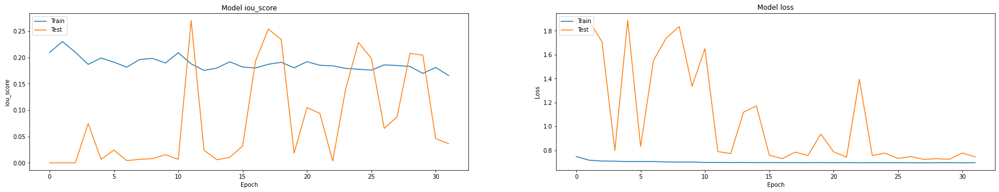

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_Vgg_DL_FL_b10_IOU0.2706.h5')

In [ ]:
scores = model.evaluate_generator(test_dataloader)

print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print("{:.5}".format(value))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


Loss: 0.79374
0.27223
0.42544
2.577e+06
2.6091e+06
1.7494e+07
4.6542e+07


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 0.79374
IOU:0.27223
F1 Score:0.42544
FN:2577030.0
FP:2609143.0
TN:17494460.0
TP:46541748.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.87022


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'Sensitivity:{Sensitivity:.5}')


Sensitivity:0.94753


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(160,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(save=True,
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
BATCH_SIZE = 12

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        total_loss = dice_loss + (1 * focal_loss)
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_Vgg_DL_FL_b12_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, min_delta=1e-4, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=20,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
139/139 [==============================] - 434s 3s/step - loss: 0.7623 - iou_score: 0.2280 - f1-score: 0.3621 - false_negatives_3: 146701584.0000 - false_positives_3: 4586540.0000 - true_negatives_3: 296236160.0000 - true_positives_3: 235688544.0000 - val_loss: 1.8802 - val_iou_score: 2.3213e-07 - val_f1-score: 4.3058e-07 - val_false_negatives_3: 45402324.0000 - val_false_positives_3: 286.0000 - val_true_negatives_3: 15627780.0000 - val_true_positives_3: 12.0000
Epoch 2/50
139/139 [==============================] - 428s 3s/step - loss: 0.7197 - iou_score: 0.2226 - f1-score: 0.3593 - false_negatives_3: 176961040.0000 - false_positives_3: 1585234.0000 - true_negatives_3: 306461888.0000 - true_positives_3: 198204672.0000 - val_loss: 1.8809 - val_iou_score: 0.0067 - val_f1-score: 0.0067 - val_false_negatives_3: 45402332.0000 - val_false_positives_3: 0.0000e+00 - val_true_negatives_3: 15628066.0000 - val_true_positives_3: 0.0000e+00
Epoch 3/50
139/139 [===========================

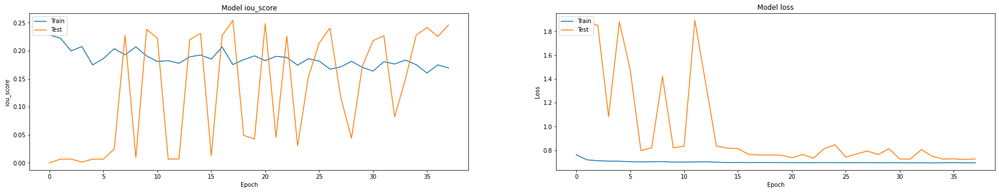

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_Vgg_DL_FL_b12_IOU0.2541.h5')

In [ ]:
scores = model.evaluate_generator(test_dataloader)
print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print(": {:.5}".format(value))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


Loss: 0.75156
: 0.27496
: 0.42893
: 5.9799e+06
: 5.5234e+05
: 1.9551e+07
: 4.3139e+07


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 0.75156
IOU:0.27496
F1 Score:0.42893
FN:5979861.0
FP:552345.0
TN:19551258.0
TP:43138928.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.97253


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'Sensitivity:{Sensitivity:.5}')

Sensitivity:0.87826


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

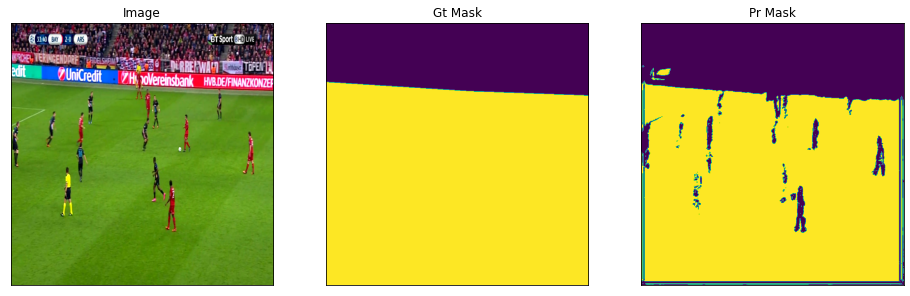

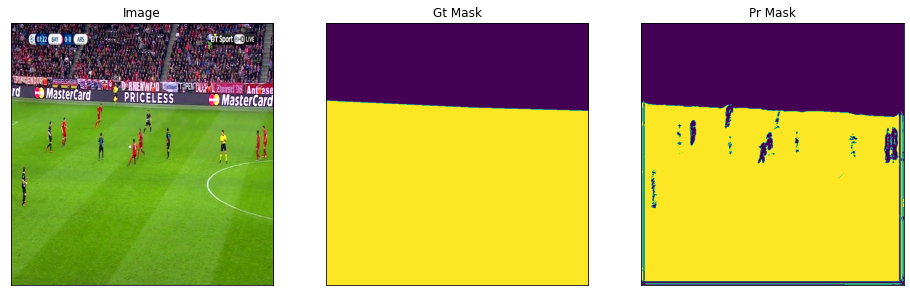

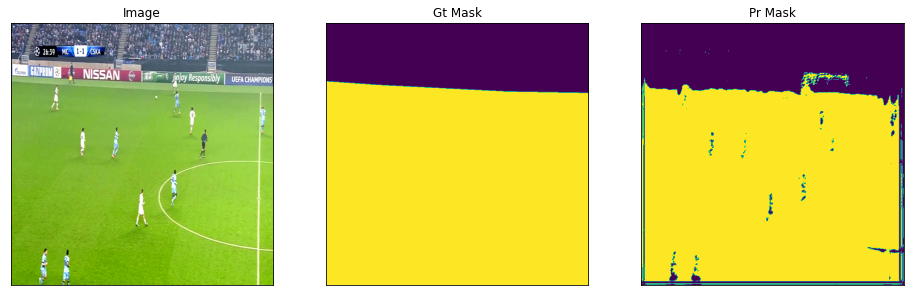

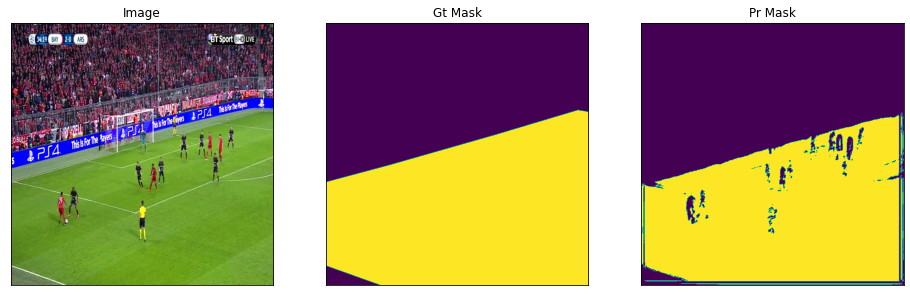

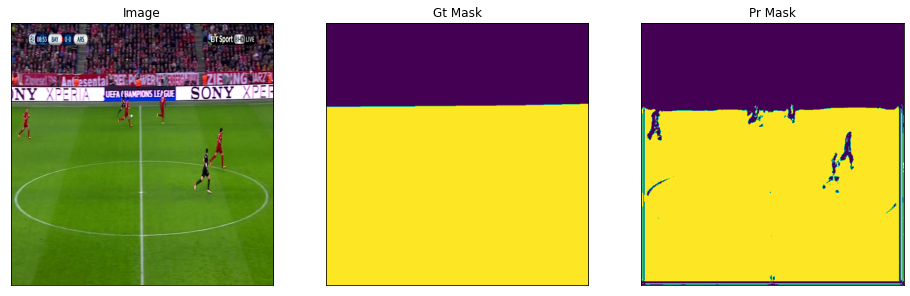

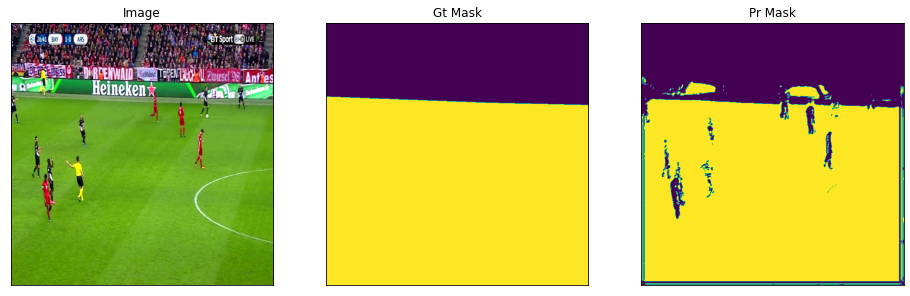

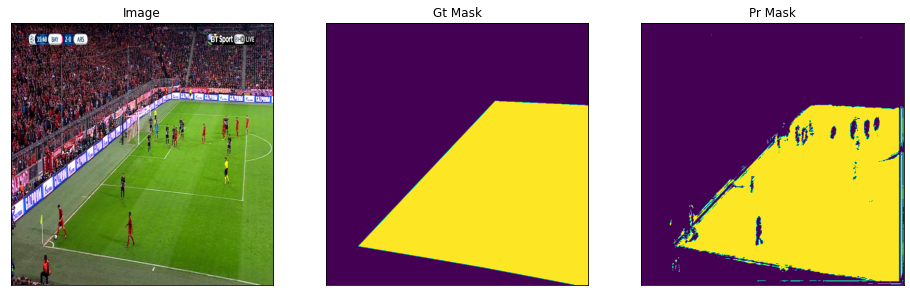

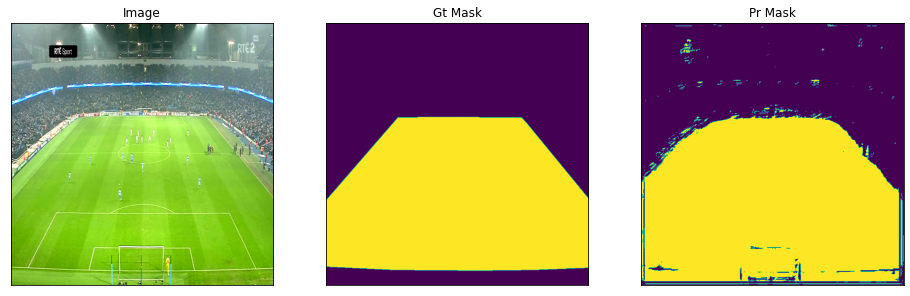

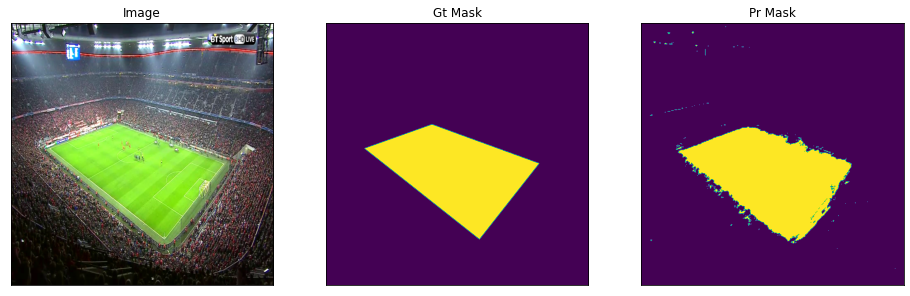

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(160,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

# Model with JL+DL

In [ ]:
BATCH_SIZE = 10

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.Precision(threshold=0.5)]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    #tf.debugging.set_log_device_placement(True)

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        jaccard_Loss = sm.losses.JaccardLoss()
        dice_loss = sm.losses.DiceLoss()
        total_loss = jaccard_Loss+dice_loss
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_VGG_JL+DL_b10_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=20,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
167/167 [==============================] - 1426s 8s/step - loss: 1.3968 - iou_score: 0.2665 - f1-score: 0.4198 - false_negatives: 36777584.0000 - false_positives: 35863052.0000 - true_negatives: 265175216.0000 - true_positives: 346216192.0000 - val_loss: 1.9976 - val_iou_score: 1.4323e-05 - val_f1-score: 2.8639e-05 - val_false_negatives: 45401636.0000 - val_false_positives: 699.0000 - val_true_negatives: 15627432.0000 - val_true_positives: 635.0000
Epoch 2/50
167/167 [==============================] - 451s 3s/step - loss: 1.3034 - iou_score: 0.2814 - f1-score: 0.4391 - false_negatives: 36863460.0000 - false_positives: 8600431.0000 - true_negatives: 297636928.0000 - true_positives: 340931232.0000 - val_loss: 1.9972 - val_iou_score: 5.5519e-06 - val_f1-score: 1.1070e-05 - val_false_negatives: 45402016.0000 - val_false_positives: 55.0000 - val_true_negatives: 15628076.0000 - val_true_positives: 244.0000
Epoch 3/50
167/167 [==============================] - 442s 3s/step - loss: 

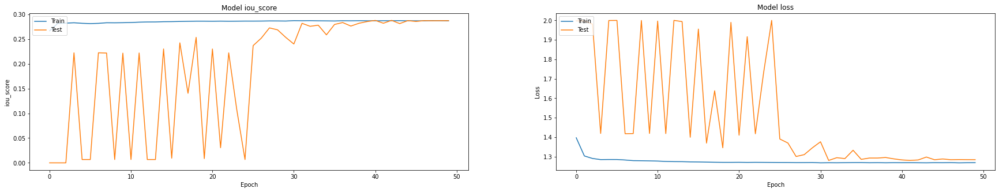

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)


In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_VGG_JL+DL_b10_IOU0.2875.h5')

In [ ]:
scores = model.evaluate_generator(test_dataloader)

print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print(": {:.5}".format(value))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


Loss: 1.279
: 0.28263
: 0.43878
: 3.0301e+06
: 6.4307e+05
: 1.9461e+07
: 4.6089e+07


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 1.279
IOU:0.28263
F1 Score:0.43878
FN:3030129.0
FP:643067.0
TN:19460538.0
TP:46088668.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.96801


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'Sensitivity:{Sensitivity:.5}')

Sensitivity:0.93831


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)


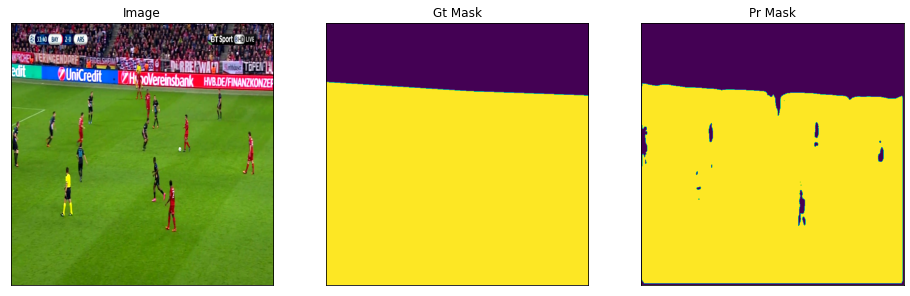

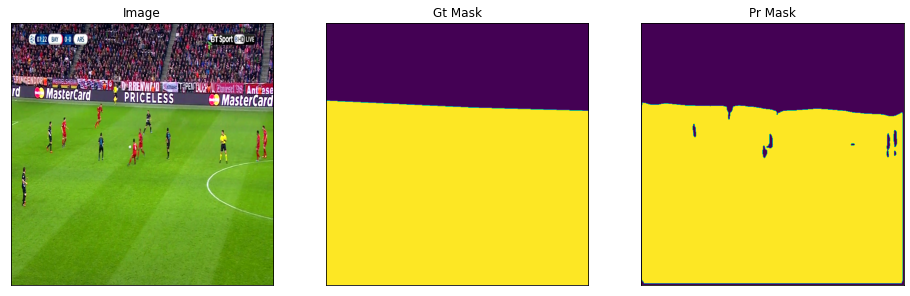

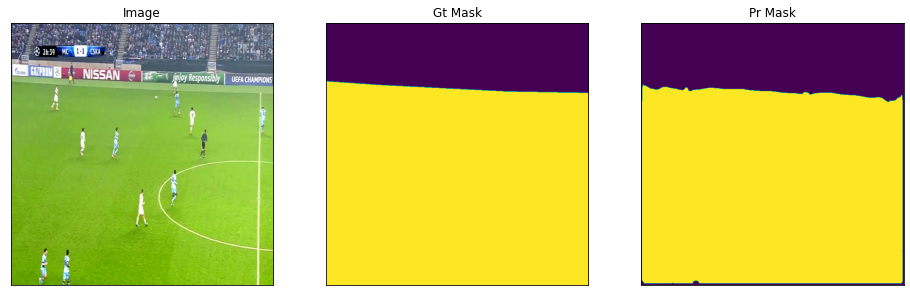

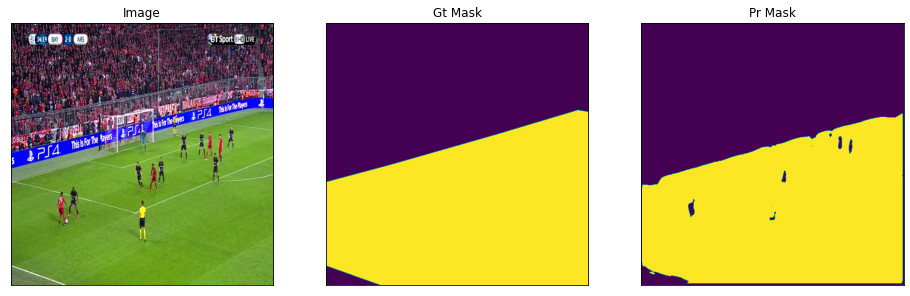

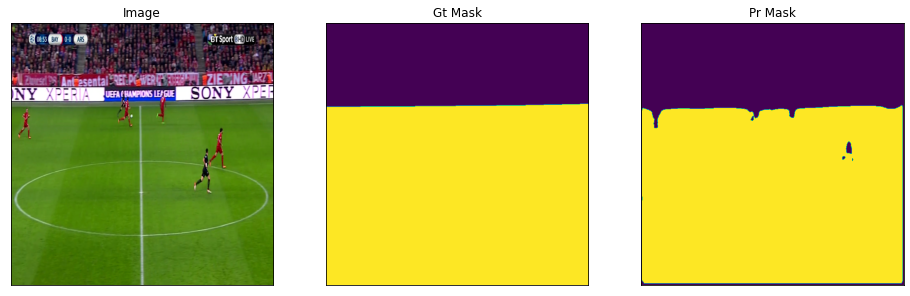

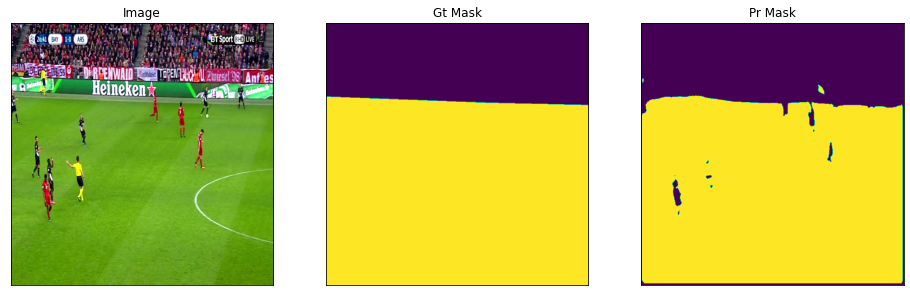

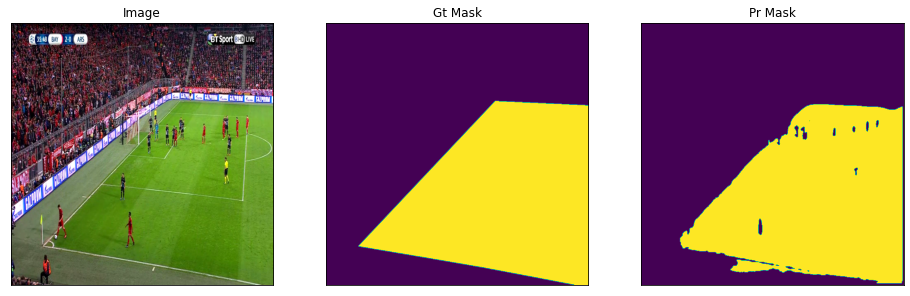

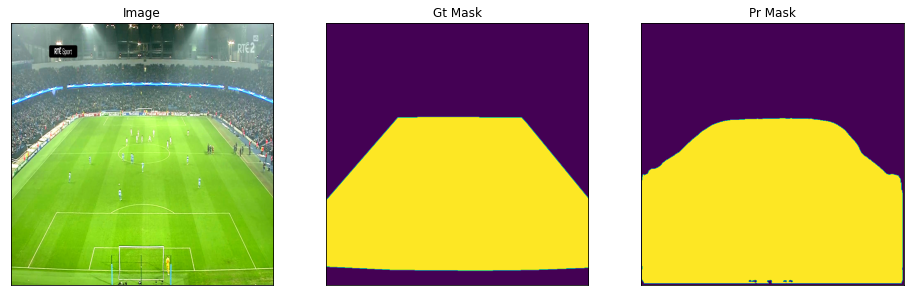

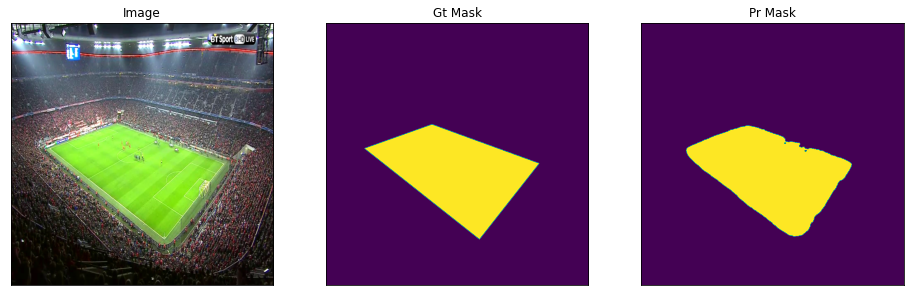

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(160,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(save=False,
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

In [ ]:
BATCH_SIZE = 12

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.Precision(threshold=0.5)]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    #tf.debugging.set_log_device_placement(True)

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        jaccard_Loss = sm.losses.JaccardLoss()
        dice_loss = sm.losses.DiceLoss()
        total_loss = jaccard_Loss+dice_loss
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_VGG_JL+DL_b12_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=20,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
139/139 [==============================] - 4607s 33s/step - loss: 1.4269 - iou_score: 0.2508 - f1-score: 0.3942 - false_negatives: 89113984.0000 - false_positives: 10695086.0000 - true_negatives: 291552128.0000 - true_positives: 291851520.0000 - val_loss: 1.9990 - val_iou_score: 0.0067 - val_f1-score: 0.0067 - val_false_negatives: 45402268.0000 - val_false_positives: 0.0000e+00 - val_true_negatives: 15628131.0000 - val_true_positives: 0.0000e+00
Epoch 2/50
139/139 [==============================] - 413s 3s/step - loss: 1.3175 - iou_score: 0.2800 - f1-score: 0.4373 - false_negatives: 42004736.0000 - false_positives: 8279560.0000 - true_negatives: 304691200.0000 - true_positives: 328237344.0000 - val_loss: 1.7391 - val_iou_score: 1.8203e-05 - val_f1-score: 3.6396e-05 - val_false_negatives: 45401448.0000 - val_false_positives: 576.0000 - val_true_negatives: 15627555.0000 - val_true_positives: 811.0000
Epoch 3/50
139/139 [==============================] - 416s 3s/step - loss: 1.

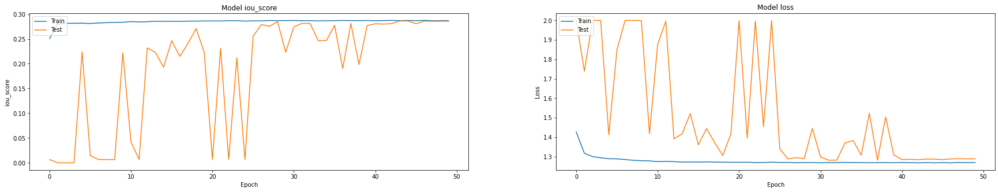

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    #augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_VGG_JL+DL_b12_IOU0.2863.h5')

In [ ]:
scores = model.evaluate(test_dataloader)

print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print("{:.5}".format(value))

169/169 [==============================] - 40s 213ms/step - loss: 1.2812 - iou_score: 0.2880 - f1-score: 0.4439 - false_negatives_5: 3390025.0000 - false_positives_5: 585909.0000 - true_negatives_5: 19517694.0000 - true_positives_5: 45728760.0000
Loss: 1.2812
0.28799
0.44391
3.39e+06
5.8591e+05
1.9518e+07
4.5729e+07


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 1.2812
IOU:0.28799
F1 Score:0.44391
FN:3390025.0
FP:585909.0
TN:19517694.0
TP:45728760.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.97086


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'Sensitivity:{Sensitivity:.5}')

Sensitivity:0.93098


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

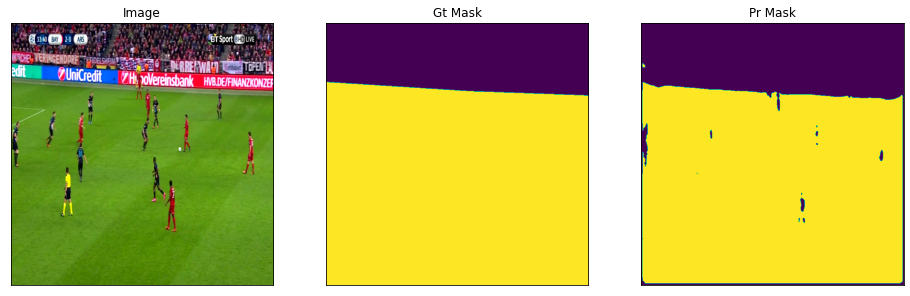

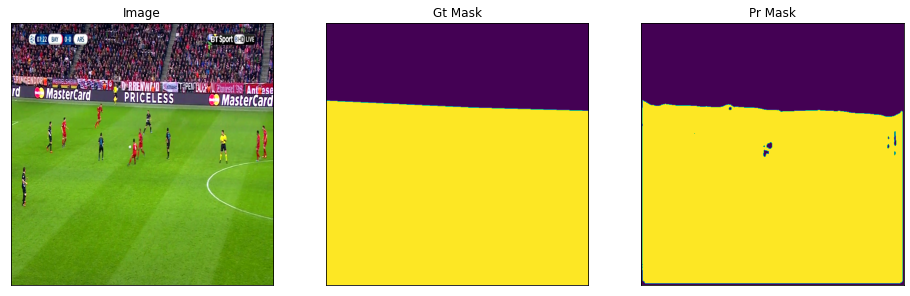

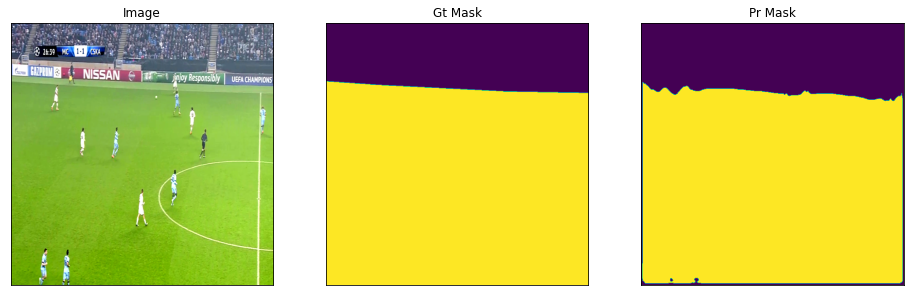

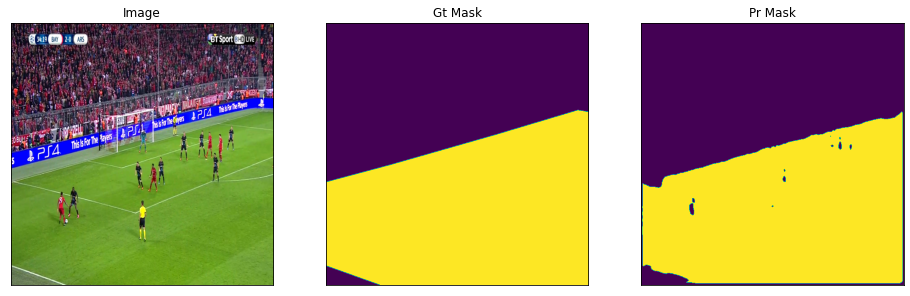

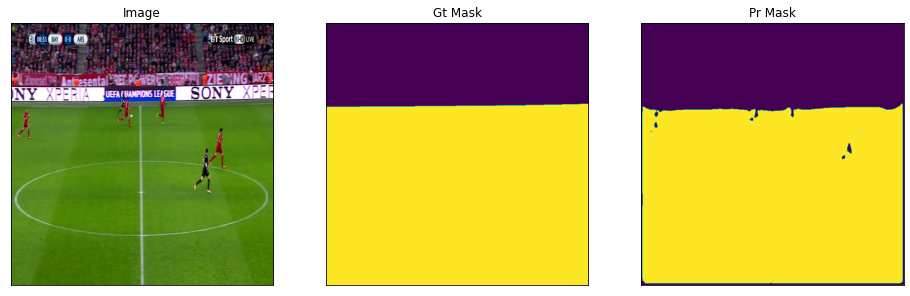

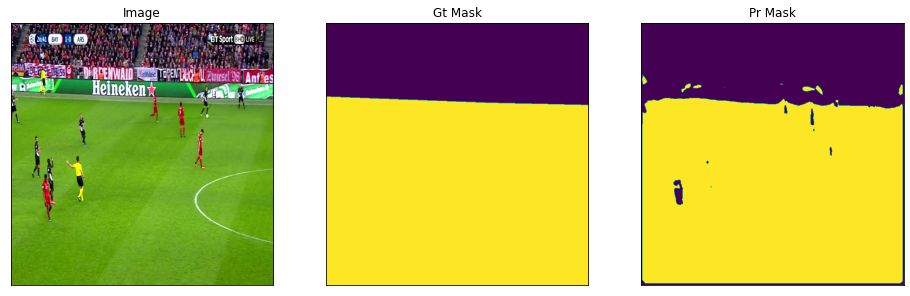

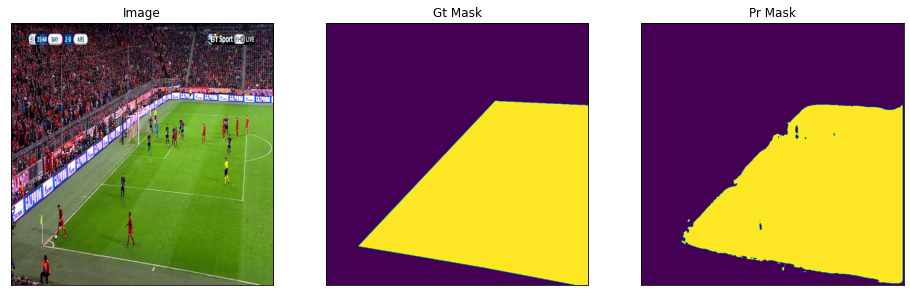

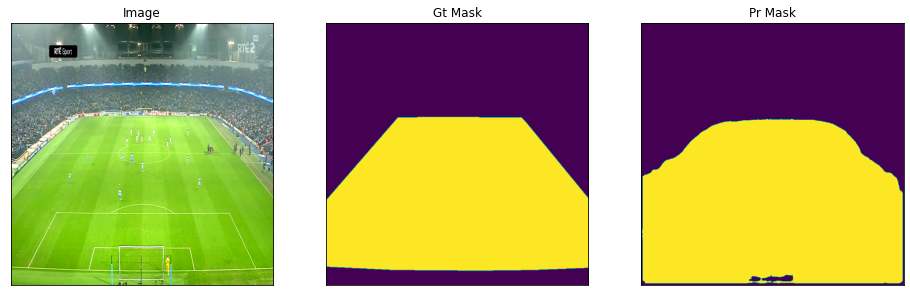

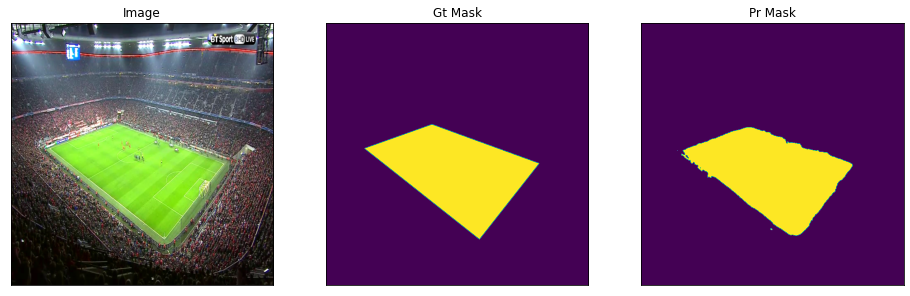

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(160,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(save=True,
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

# Model with JPL

In [ ]:
BATCH_SIZE = 10

In [ ]:
def jaccard_pow_loss(y_true, y_pred, p_value=2.0,smooth = 10):
    p_value = POWER_VALUE
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)

    intersection = K.sum(y_true_f * y_pred_f)
    term_true = K.sum(K.pow(y_true_f, p_value))
    term_pred = K.sum(K.pow(y_pred_f, p_value))
    union = term_true + term_pred - intersection
    return 1 - ((intersection + smooth) / (union + smooth))

In [ ]:
POWER_VALUE = 1.5

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        total_loss = jaccard_pow_loss
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.Precision(threshold=0.5)]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    #tf.debugging.set_log_device_placement(True)

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        total_loss = jaccard_pow_loss
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]
        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_VGG_JPL_b10_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=10,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
167/167 [==============================] - 434s 2s/step - loss: 0.6689 - iou_score: 0.2668 - f1-score: 0.4204 - false_negatives_1: 53918688.0000 - false_positives_1: 25546584.0000 - true_negatives_1: 278283168.0000 - true_positives_1: 326283488.0000 - val_loss: 0.9933 - val_iou_score: 0.0028 - val_f1-score: 0.0057 - val_false_negatives_1: 45269232.0000 - val_false_positives_1: 57835.0000 - val_true_negatives_1: 15570296.0000 - val_true_positives_1: 133031.0000
Epoch 2/50
167/167 [==============================] - 411s 2s/step - loss: 0.6267 - iou_score: 0.2716 - f1-score: 0.4269 - false_negatives_1: 80490736.0000 - false_positives_1: 5044266.0000 - true_negatives_1: 297906272.0000 - true_positives_1: 300590720.0000 - val_loss: 0.9933 - val_iou_score: 0.0028 - val_f1-score: 0.0056 - val_false_negatives_1: 45270016.0000 - val_false_positives_1: 56535.0000 - val_true_negatives_1: 15571596.0000 - val_true_positives_1: 132263.0000
Epoch 3/50
167/167 [=============================

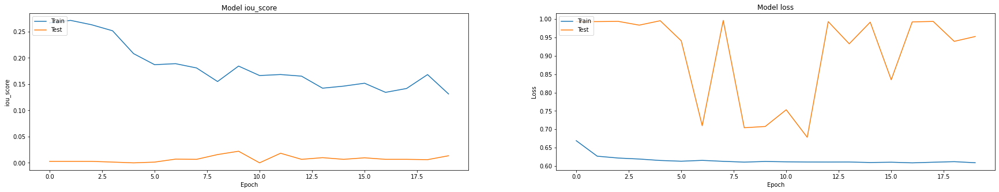

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_VGG_JPL_b10_IOU0.0222.h5')

In [ ]:
scores = model.evaluate_generator(test_dataloader)

print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print(": {:.5}".format(value))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


Loss: 0.72015
: 0.020537
: 0.040104
: 4.7833e+07
: 3.0077e+06
: 1.7096e+07
: 1.2862e+06


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 0.72015
IOU:0.020537
F1 Score:0.040104
FN:47832572.0
FP:3007653.0
TN:17095948.0
TP:1286222.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.85039


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'Sensitivity:{Sensitivity:.5}')

Sensitivity:0.026186


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(160,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(save=True,
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
BATCH_SIZE = 12

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        total_loss = jaccard_pow_loss
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.Precision(threshold=0.5)]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    #tf.debugging.set_log_device_placement(True)

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        total_loss = jaccard_pow_loss
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]
        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_VGG_JPL_b12_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=10,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
139/139 [==============================] - 423s 3s/step - loss: 0.6761 - iou_score: 0.2701 - f1-score: 0.4247 - false_negatives_2: 52286576.0000 - false_positives_2: 16093804.0000 - true_negatives_2: 290510560.0000 - true_positives_2: 324321792.0000 - val_loss: 0.9918 - val_iou_score: 7.0636e-06 - val_f1-score: 1.4119e-05 - val_false_negatives_2: 45401940.0000 - val_false_positives_2: 1011.0000 - val_true_negatives_2: 15627120.0000 - val_true_positives_2: 324.0000
Epoch 2/50
139/139 [==============================] - 412s 3s/step - loss: 0.6257 - iou_score: 0.2638 - f1-score: 0.4173 - false_negatives_2: 106499696.0000 - false_positives_2: 2232788.0000 - true_negatives_2: 305502016.0000 - true_positives_2: 268978240.0000 - val_loss: 0.9896 - val_iou_score: 2.8624e-06 - val_f1-score: 5.6576e-06 - val_false_negatives_2: 45402148.0000 - val_false_positives_2: 26.0000 - val_true_negatives_2: 15628105.0000 - val_true_positives_2: 123.0000
Epoch 3/50
139/139 [======================

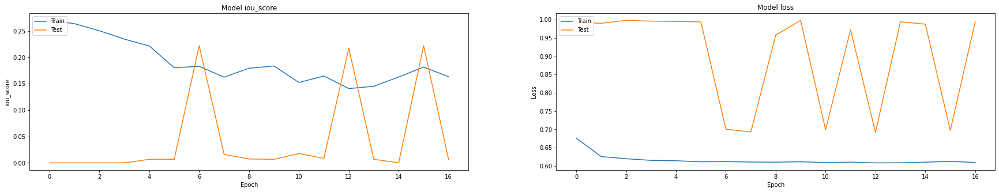

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_VGG_JPL_b12_IOU0.2222.h5')

In [ ]:
scores = model.evaluate_generator(test_dataloader)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


In [ ]:
print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print(": {:.5}".format(value))


Loss: 0.71442
: 0.21278
: 0.34746
: 1.7056e+06
: 1.834e+07
: 1.7632e+06
: 4.7413e+07


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 0.71442
IOU:0.21278
F1 Score:0.34746
FN:1705601.0
FP:18340366.0
TN:1763233.0
TP:47413180.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.087707


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'Sensitivity:{Sensitivity:.5}')

Sensitivity:0.96528


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

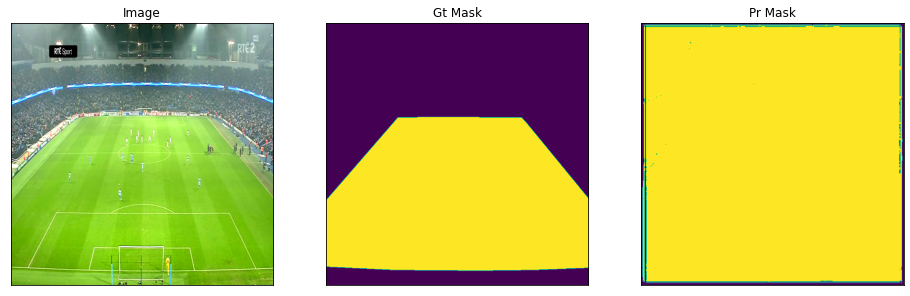

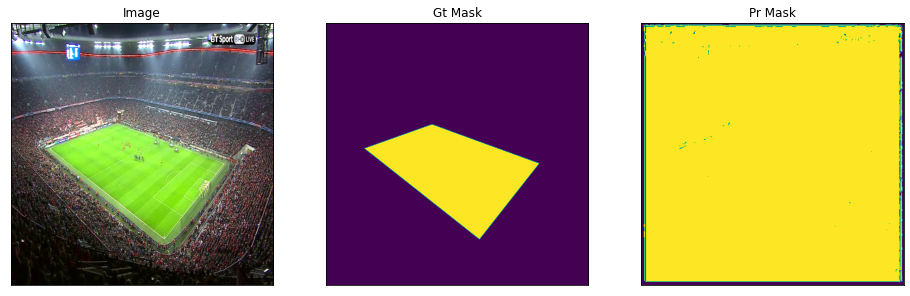

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(167,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

# Model with JL+BCE

In [ ]:
BATCH_SIZE = 10

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.Precision(), tf.keras.metrics.Accuracy()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    #tf.debugging.set_log_device_placement(True)

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        jaccard_Loss = sm.losses.JaccardLoss()
        bce = sm.losses.BinaryCELoss()
        total_loss = jaccard_Loss + bce
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_VGG_JL+BCE_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, mode='min'),
    #keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=10,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
167/167 [==============================] - 426s 3s/step - loss: 1.3252 - iou_score: 0.0904 - f1-score: 0.1554 - false_negatives_3: 292759744.0000 - false_positives_3: 12022986.0000 - true_negatives_3: 300833504.0000 - true_positives_3: 78415776.0000 - val_loss: 4.3534 - val_iou_score: 1.7564e-05 - val_f1-score: 3.5122e-05 - val_false_negatives_3: 45401500.0000 - val_false_positives_3: 1049.0000 - val_true_negatives_3: 15627082.0000 - val_true_positives_3: 783.0000
Epoch 2/50
167/167 [==============================] - 419s 3s/step - loss: 1.2075 - iou_score: 0.0018 - f1-score: 0.0036 - false_negatives_3: 379416384.0000 - false_positives_3: 66566.0000 - true_negatives_3: 303839200.0000 - true_positives_3: 709897.0000 - val_loss: 4.3251 - val_iou_score: 2.8816e-06 - val_f1-score: 5.7295e-06 - val_false_negatives_3: 45402148.0000 - val_false_positives_3: 196.0000 - val_true_negatives_3: 15627935.0000 - val_true_positives_3: 127.0000
Epoch 3/50
167/167 [==========================

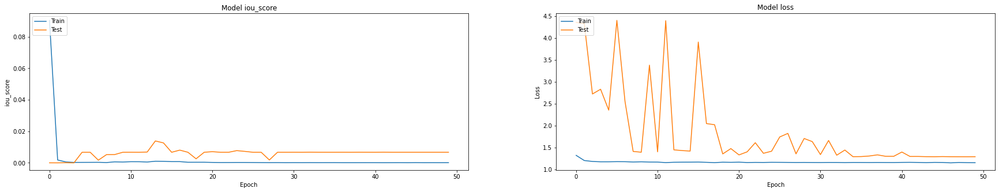

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_VGG_JL+BCE_IOU0.0139.h5')

In [ ]:
scores = model.evaluate(test_dataloader)

print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print(": {:.5}".format(value))

169/169 [==============================] - 87s 514ms/step - loss: 1.4387 - iou_score: 0.0140 - f1-score: 0.0275 - false_negatives_1: 48405340.0000 - false_positives_1: 404448.0000 - true_negatives_1: 19699136.0000 - true_positives_1: 713471.0000
Loss: 1.4387
: 0.013977
: 0.027513
: 4.8405e+07
: 4.0445e+05
: 1.9699e+07
: 7.1347e+05


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 1.4387
IOU:0.013977
F1 Score:0.027513
FN:48405340.0
FP:404448.0
TN:19699136.0
TP:713471.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.97988


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'SP:{Sensitivity:.5}')

SP:0.014525


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

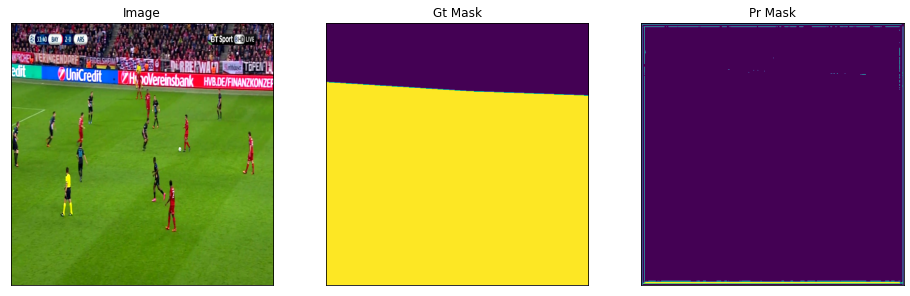

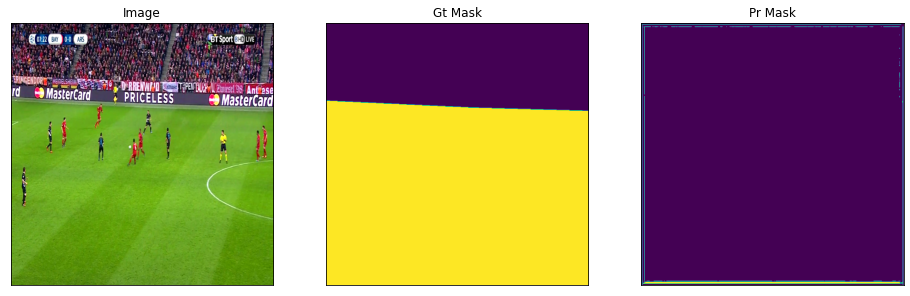

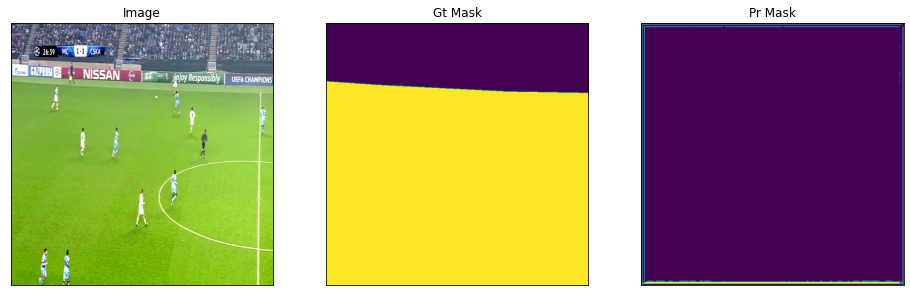

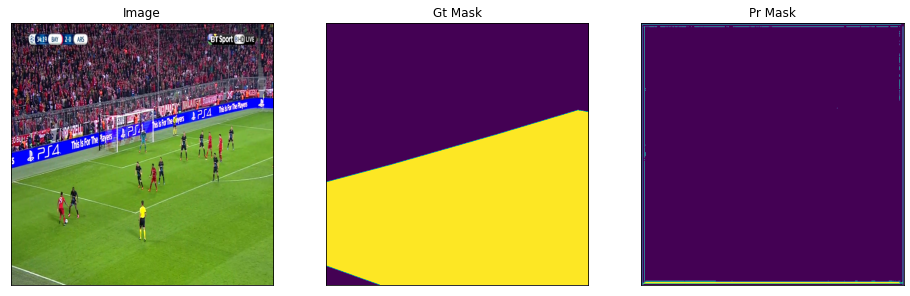

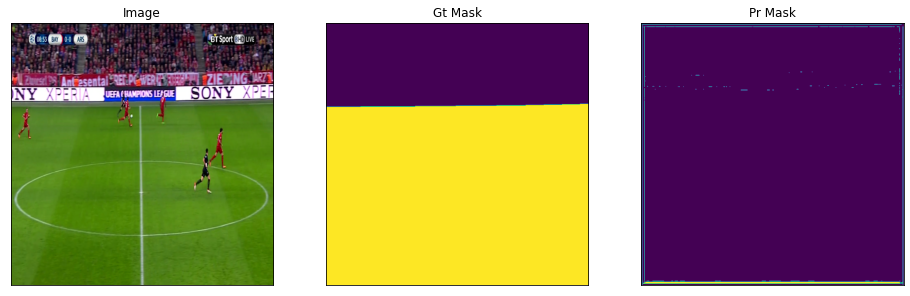

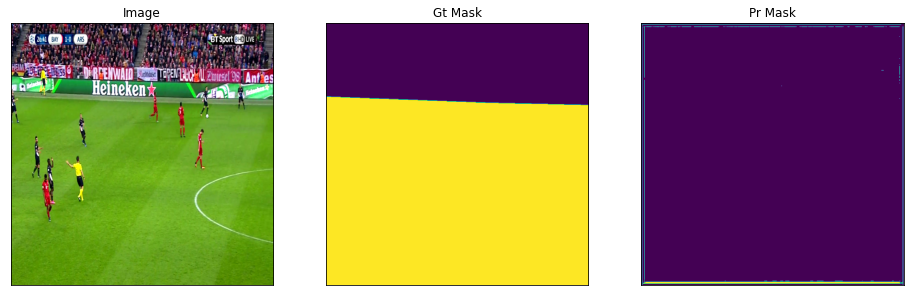

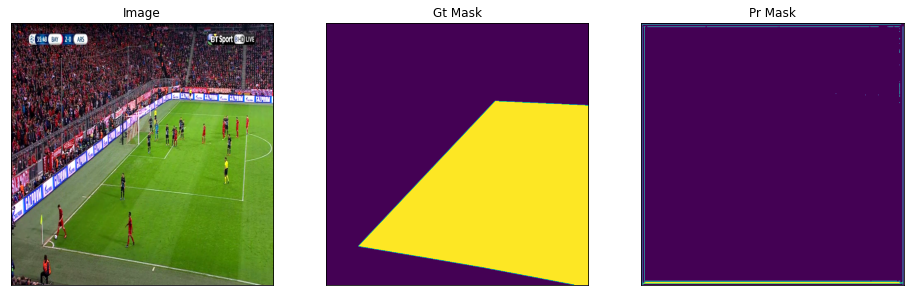

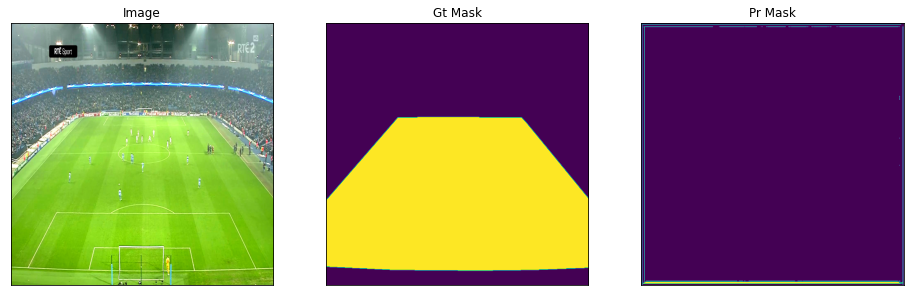

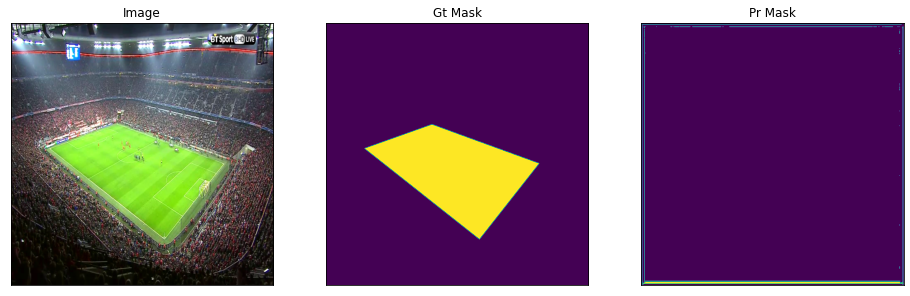

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(160,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(save=False,
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

In [ ]:
BATCH_SIZE = 12

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.Precision(), tf.keras.metrics.Accuracy()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    #tf.debugging.set_log_device_placement(True)

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        jaccard_Loss = sm.losses.JaccardLoss()
        bce = sm.losses.BinaryCELoss()
        total_loss = jaccard_Loss + bce
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_VGG_JL+BCE_b12_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=20,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
139/139 [==============================] - 2377s 17s/step - loss: 1.2851 - iou_score: 0.0397 - f1-score: 0.0667 - false_negatives: 343687520.0000 - false_positives: 1868067.0000 - true_negatives: 307315584.0000 - true_positives: 30341780.0000 - val_loss: 3.8692 - val_iou_score: 0.0015 - val_f1-score: 0.0030 - val_false_negatives: 45332832.0000 - val_false_positives: 17706.0000 - val_true_negatives: 15610425.0000 - val_true_positives: 69425.0000
Epoch 2/50
139/139 [==============================] - 421s 3s/step - loss: 1.1930 - iou_score: 0.0014 - f1-score: 0.0029 - false_negatives: 373123040.0000 - false_positives: 43209.0000 - true_negatives: 309521824.0000 - true_positives: 524608.0000 - val_loss: 4.0904 - val_iou_score: 2.8446e-06 - val_f1-score: 5.6220e-06 - val_false_negatives: 45402148.0000 - val_false_positives: 23.0000 - val_true_negatives: 15628108.0000 - val_true_positives: 122.0000
Epoch 3/50
139/139 [==============================] - 416s 3s/step - loss: 1.1881 -

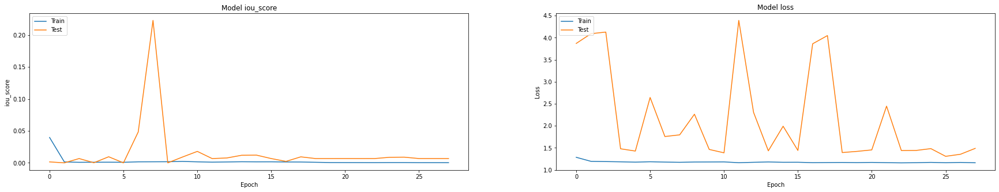

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_VGG_JL+BCE_b12_IOU0.2228.h5')

In [ ]:
scores = model.evaluate_generator(test_dataloader)

print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print(": {:.5}".format(value))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


Loss: 1.8008
: 0.21266
: 0.34729
: 8.3267e+05
: 1.9013e+07
: 1.0901e+06
: 4.8286e+07


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 1.8008
IOU:0.21266
F1 Score:0.34729
FN:832668.0
FP:19013452.0
TN:1090123.0
TP:48286156.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.054225


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'SP:{Sensitivity:.5}')

SP:0.98305


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

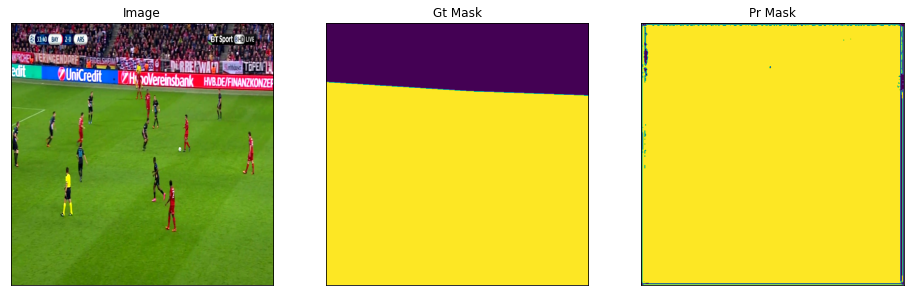

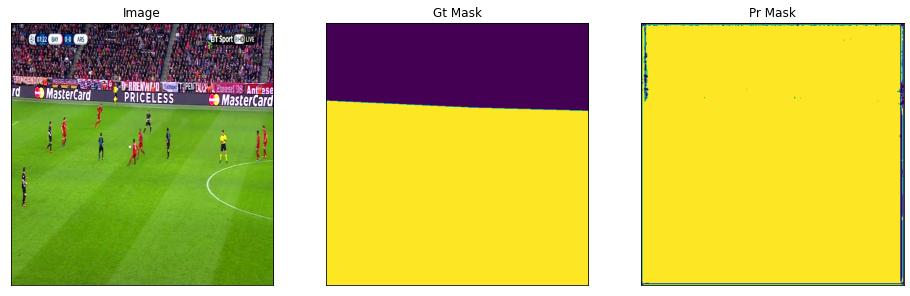

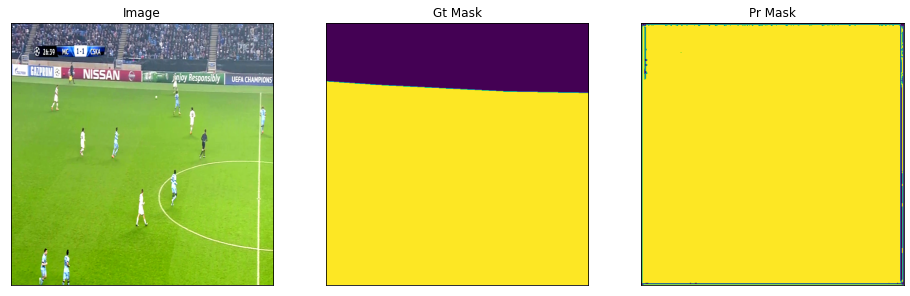

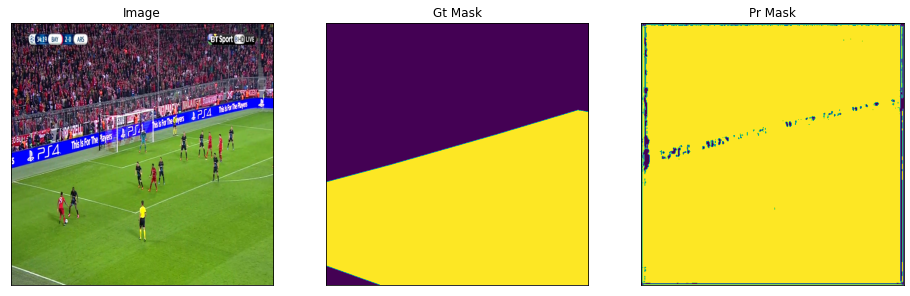

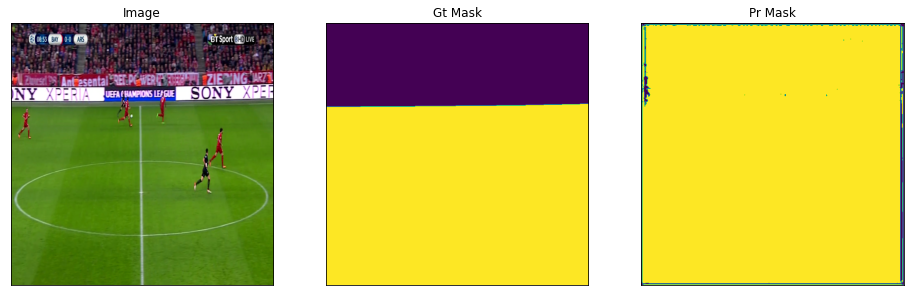

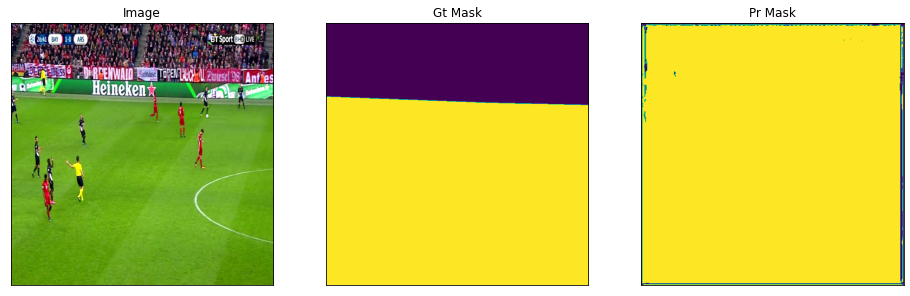

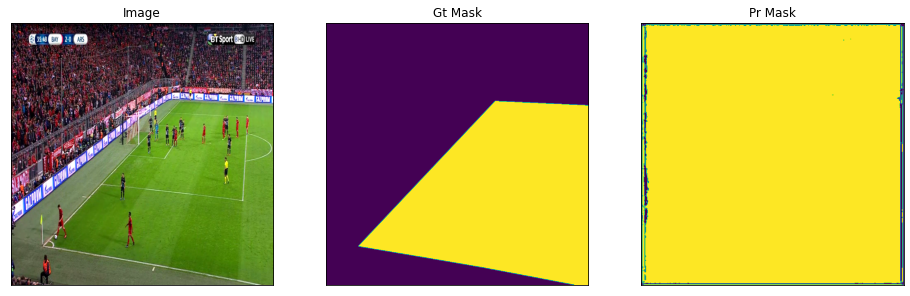

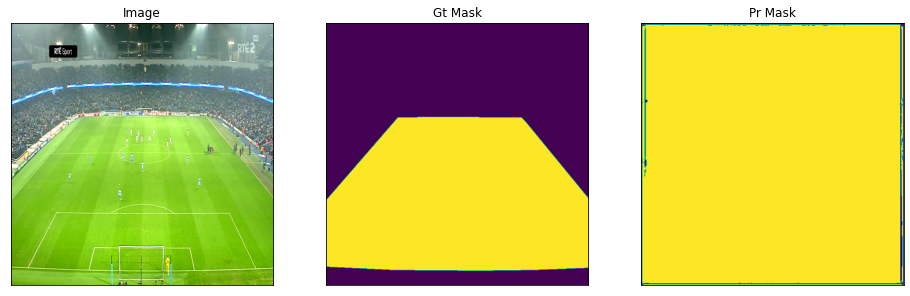

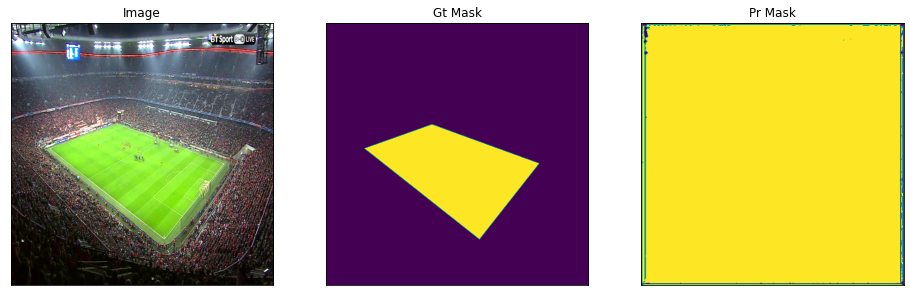

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(160,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(save=False,
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

# Model with BCE

In [ ]:
BATCH_SIZE = 10

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.Precision(), tf.keras.metrics.Accuracy()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    #tf.debugging.set_log_device_placement(True)

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        bce = sm.losses.BinaryCELoss()
        total_loss = bce
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_VGG_BCE_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, mode='min'),
    #keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=10,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
167/167 [==============================] - 436s 3s/step - loss: 0.4314 - iou_score: 0.0038 - f1-score: 0.0074 - false_negatives_1: 375451008.0000 - false_positives_1: 1523136.0000 - true_negatives_1: 305466688.0000 - true_positives_1: 1591110.0000 - val_loss: 1.4929 - val_iou_score: 0.0067 - val_f1-score: 0.0067 - val_false_negatives_1: 45402268.0000 - val_false_positives_1: 13.0000 - val_true_negatives_1: 15628118.0000 - val_true_positives_1: 0.0000e+00
Epoch 2/50
167/167 [==============================] - 426s 3s/step - loss: 0.3728 - iou_score: 1.4608e-05 - f1-score: 2.9214e-05 - false_negatives_1: 380753120.0000 - false_positives_1: 12910.0000 - true_negatives_1: 303260448.0000 - true_positives_1: 5605.0000 - val_loss: 3.3575 - val_iou_score: 0.0067 - val_f1-score: 0.0067 - val_false_negatives_1: 45402268.0000 - val_false_positives_1: 0.0000e+00 - val_true_negatives_1: 15628131.0000 - val_true_positives_1: 0.0000e+00
Epoch 3/50
167/167 [==============================] - 

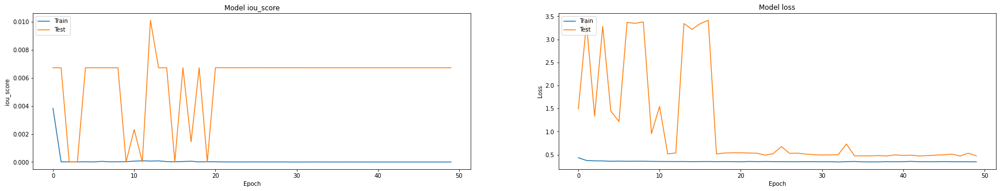

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_VGG_BCE_IOU0.0101.h5')

In [ ]:
scores = model.evaluate_generator(test_dataloader)

print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print(": {:.5}".format(value))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


Loss: 0.51155
: 0.009874
: 0.013796
: 4.8919e+07
: 8200.0
: 2.0095e+07
: 2e+05


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 0.51155
IOU:0.009874
F1 Score:0.013796
FN:48918816.0
FP:8200.0
TN:20095376.0
TP:200003.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.99959


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'SP:{Sensitivity:.5}')

SP:0.0040718


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

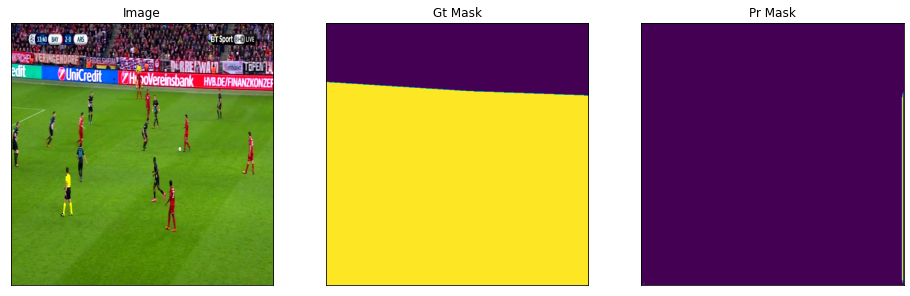

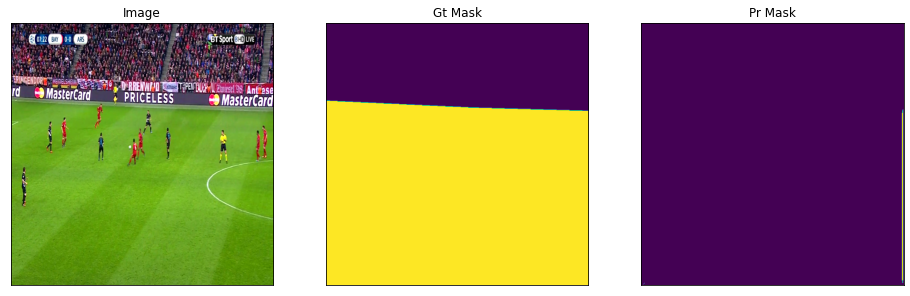

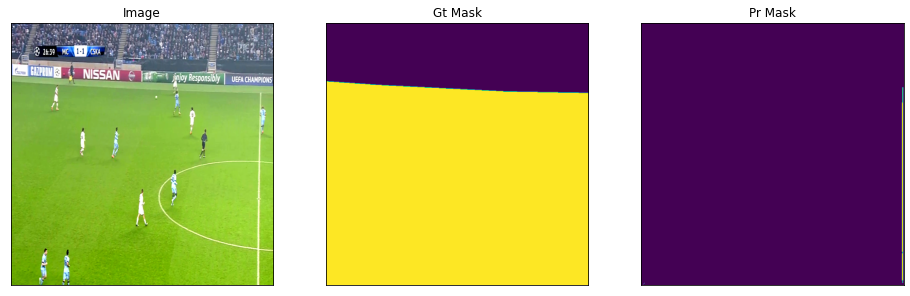

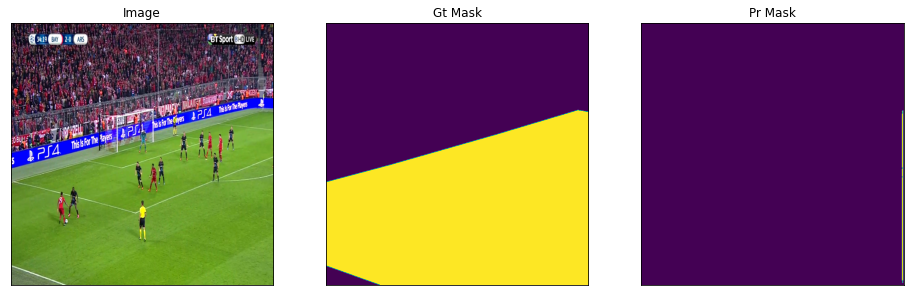

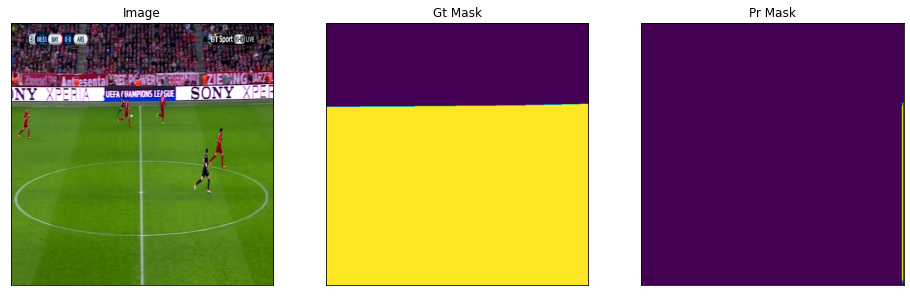

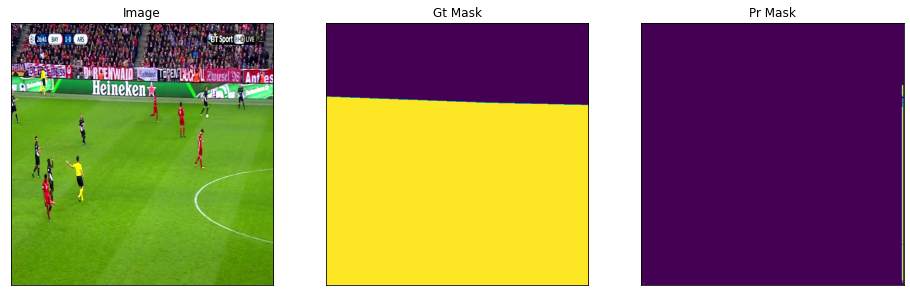

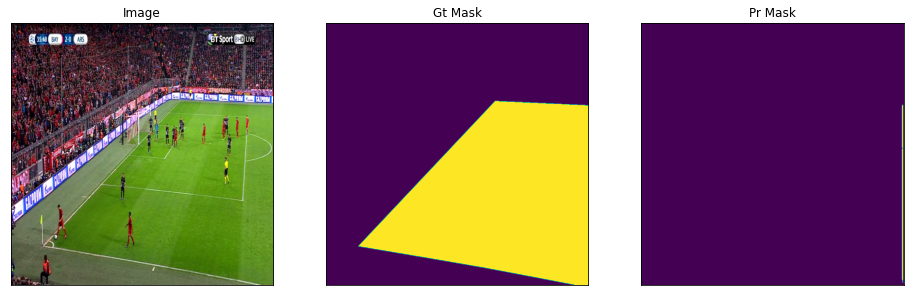

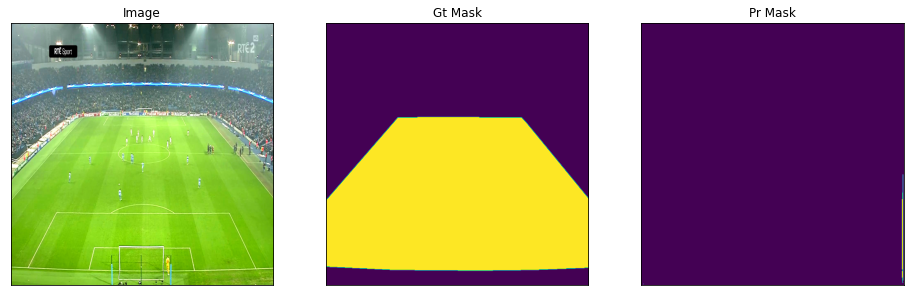

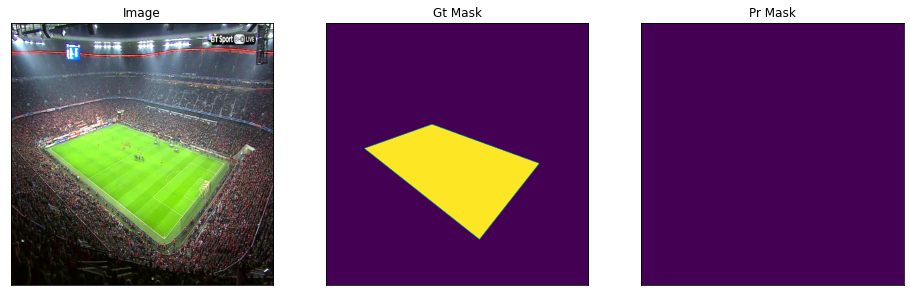

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(160,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(save=False,
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

In [ ]:
BATCH_SIZE = 12

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.Precision(), tf.keras.metrics.Accuracy()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    #tf.debugging.set_log_device_placement(True)

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        bce = sm.losses.BinaryCELoss()
        total_loss = bce
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_VGG_BCE_b12_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=20,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
139/139 [==============================] - 429s 3s/step - loss: 0.4583 - iou_score: 0.0265 - f1-score: 0.0479 - false_negatives_2: 362208096.0000 - false_positives_2: 4522763.0000 - true_negatives_2: 300143968.0000 - true_positives_2: 16337859.0000 - val_loss: 2.7991 - val_iou_score: 0.0029 - val_f1-score: 0.0058 - val_false_negatives_2: 45266120.0000 - val_false_positives_2: 53738.0000 - val_true_negatives_2: 15574393.0000 - val_true_positives_2: 136151.0000
Epoch 2/50
139/139 [==============================] - 427s 3s/step - loss: 0.3753 - iou_score: 8.5597e-05 - f1-score: 1.7111e-04 - false_negatives_2: 371192512.0000 - false_positives_2: 18279.0000 - true_negatives_2: 311972608.0000 - true_positives_2: 29420.0000 - val_loss: 1.9371 - val_iou_score: 3.3076e-06 - val_f1-score: 6.6039e-06 - val_false_negatives_2: 45402120.0000 - val_false_positives_2: 828.0000 - val_true_negatives_2: 15627303.0000 - val_true_positives_2: 152.0000
Epoch 3/50
139/139 [========================

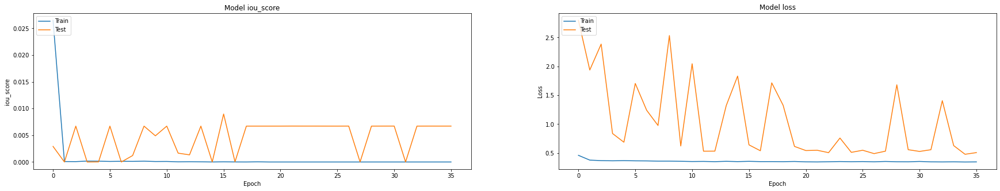

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_VGG_BCE_b12_IOU0.0090.h5')

In [ ]:
scores = model.evaluate_generator(test_dataloader)

print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print(": {:.5}".format(value))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


Loss: 0.62159
: 0.010666
: 0.02108
: 4.8571e+07
: 1.1818e+05
: 1.9985e+07
: 5.4748e+05


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 0.62159
IOU:0.010666
F1 Score:0.02108
FN:48571344.0
FP:118176.0
TN:19985398.0
TP:547476.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.99412


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'SP:{Sensitivity:.5}')

SP:0.011146


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

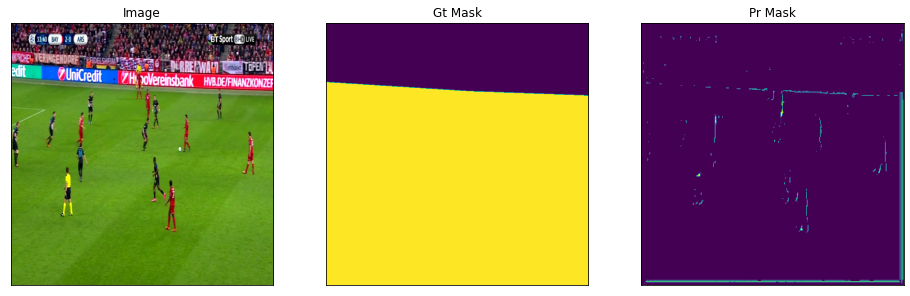

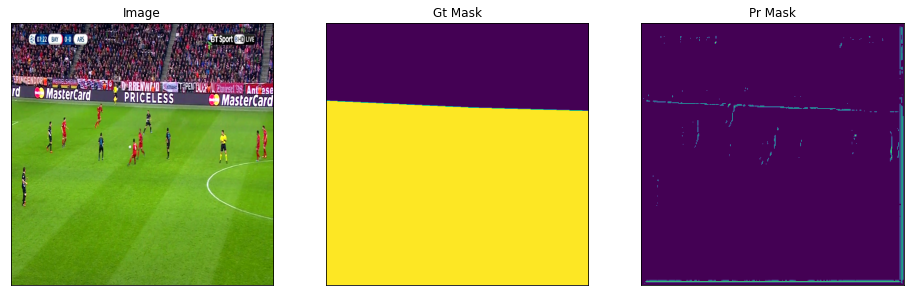

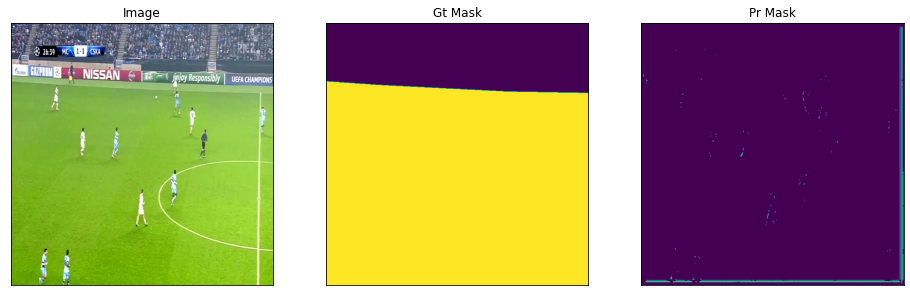

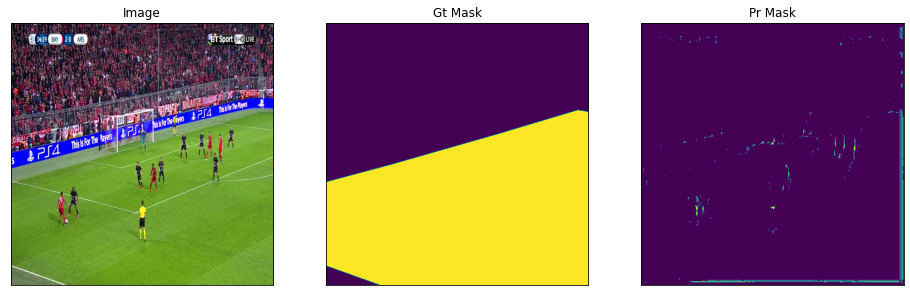

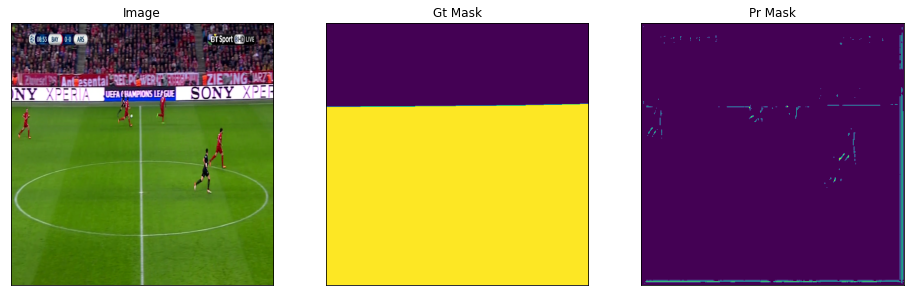

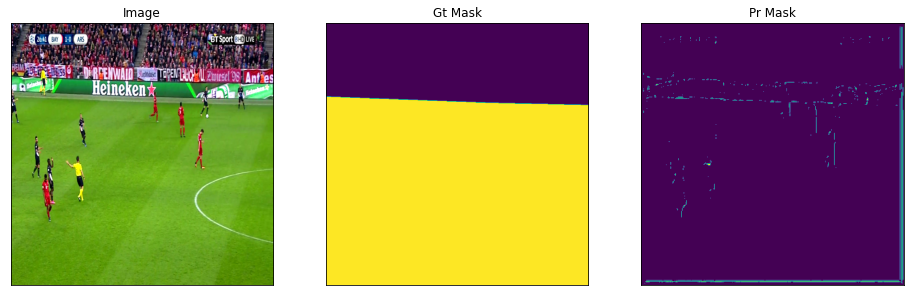

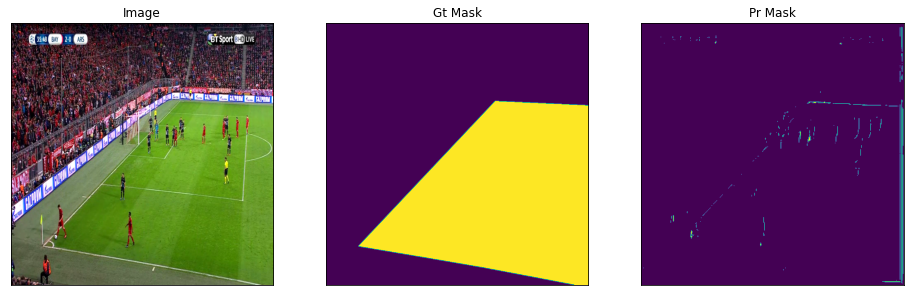

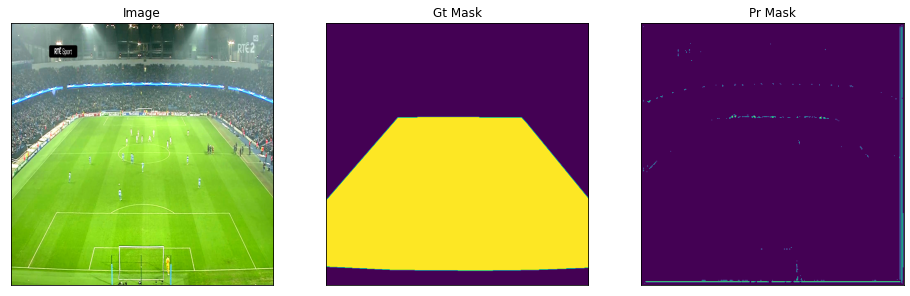

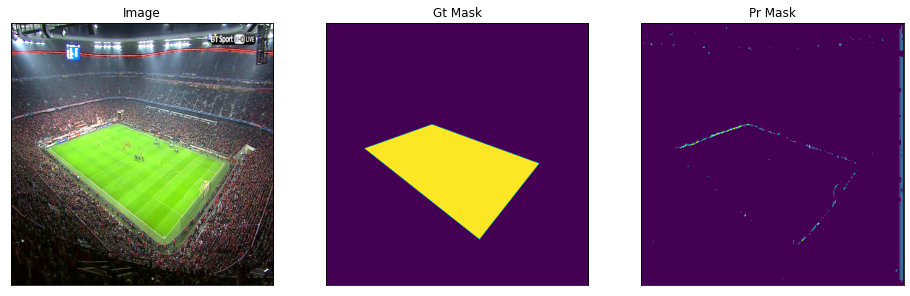

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(160,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(save=False,
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

# Model With BCE+DL

In [ ]:
BATCH_SIZE = 12

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.Precision(), tf.keras.metrics.Accuracy()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    #tf.debugging.set_log_device_placement(True)

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        bce = sm.losses.BinaryCELoss()
        total_loss = bce+dice_loss
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_VGG_DL+BCE_b12_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=20,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
139/139 [==============================] - 2197s 16s/step - loss: 1.1425 - iou_score: 0.0525 - f1-score: 0.0944 - false_negatives_6: 344931136.0000 - false_positives_6: 2235309.0000 - true_negatives_6: 309251712.0000 - true_positives_6: 26794648.0000 - val_loss: 4.3483 - val_iou_score: 3.0707e-05 - val_f1-score: 6.1405e-05 - val_false_negatives_6: 45400920.0000 - val_false_positives_6: 277.0000 - val_true_negatives_6: 15627854.0000 - val_true_positives_6: 1351.0000
Epoch 2/50
139/139 [==============================] - 422s 3s/step - loss: 1.0571 - iou_score: 0.0087 - f1-score: 0.0171 - false_negatives_6: 368582976.0000 - false_positives_6: 146352.0000 - true_negatives_6: 311150048.0000 - true_positives_6: 3333410.0000 - val_loss: 4.3618 - val_iou_score: 8.4079e-06 - val_f1-score: 1.6793e-05 - val_false_negatives_6: 45401896.0000 - val_false_positives_6: 79.0000 - val_true_negatives_6: 15628052.0000 - val_true_positives_6: 369.0000
Epoch 3/50
139/139 [========================

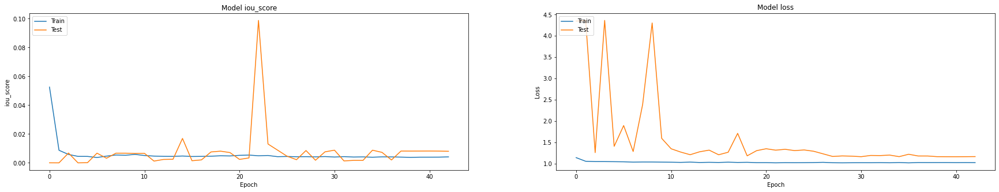

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_VGG_DL+BCE_b12_IOU0.0988.h5')

In [ ]:
scores = model.evaluate_generator(test_dataloader)
print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print(": {:.5}".format(value))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


Loss: 1.3403
: 0.1696
: 0.27658
: 2.9504e+07
: 2.9271e+05
: 1.9811e+07
: 1.9615e+07


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 1.3403
IOU:0.1696
F1 Score:0.27658
FN:29504160.0
FP:292709.0
TN:19810870.0
TP:19614660.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.98544


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'SP:{Sensitivity:.5}')

SP:0.39933


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(160,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
BATCH_SIZE = 10

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.Precision(), tf.keras.metrics.Accuracy()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    #tf.debugging.set_log_device_placement(True)

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        bce = sm.losses.BinaryCELoss()
        total_loss = bce+dice_loss
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640, 640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_VGG_DL+BCE_b10_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=20,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
167/167 [==============================] - 2883s 17s/step - loss: 1.2045 - iou_score: 0.1551 - f1-score: 0.2526 - false_negatives_1: 211118992.0000 - false_positives_1: 12703977.0000 - true_negatives_1: 298623968.0000 - true_positives_1: 161585120.0000 - val_loss: 3.5823 - val_iou_score: 8.5402e-06 - val_f1-score: 1.7067e-05 - val_false_negatives_1: 45401944.0000 - val_false_positives_1: 366.0000 - val_true_negatives_1: 15627700.0000 - val_true_positives_1: 378.0000
Epoch 2/50
167/167 [==============================] - 421s 3s/step - loss: 1.0783 - iou_score: 0.0410 - f1-score: 0.0735 - false_negatives_1: 356989696.0000 - false_positives_1: 249397.0000 - true_negatives_1: 304750304.0000 - true_positives_1: 22042432.0000 - val_loss: 3.5356 - val_iou_score: 0.0067 - val_f1-score: 0.0067 - val_false_negatives_1: 45402332.0000 - val_false_positives_1: 0.0000e+00 - val_true_negatives_1: 15628066.0000 - val_true_positives_1: 0.0000e+00
Epoch 3/50
167/167 [=========================

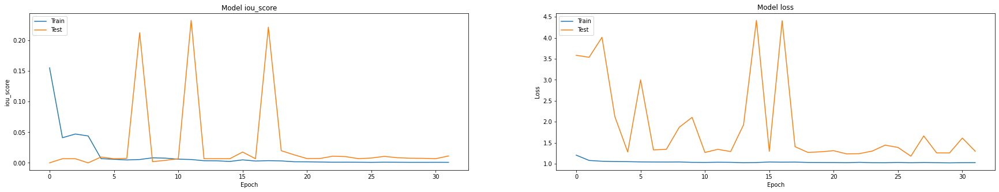

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_VGG_DL+BCE_b10_IOU0.2326.h5')

In [ ]:
scores = model.evaluate_generator(test_dataloader)

print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print(": {:.5}".format(value))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


Loss: 1.3436
: 0.25268
: 0.39607
: 1.0667e+07
: 5.4884e+05
: 1.9555e+07
: 3.8452e+07


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 1.3436
IOU:0.25268
F1 Score:0.39607
FN:10666811.0
FP:548842.0
TN:19554736.0
TP:38452000.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.9727


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'SP:{Sensitivity:.5}')

SP:0.78284


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

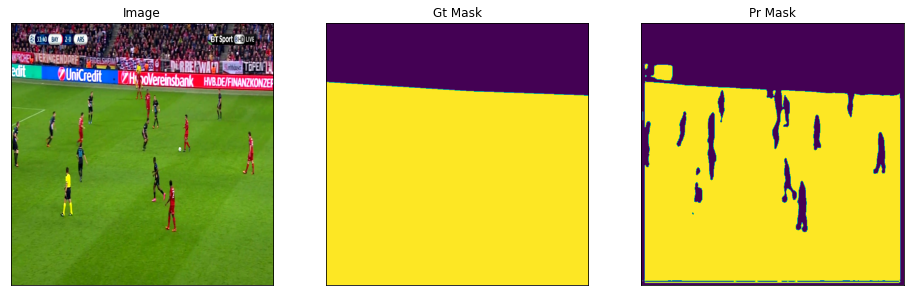

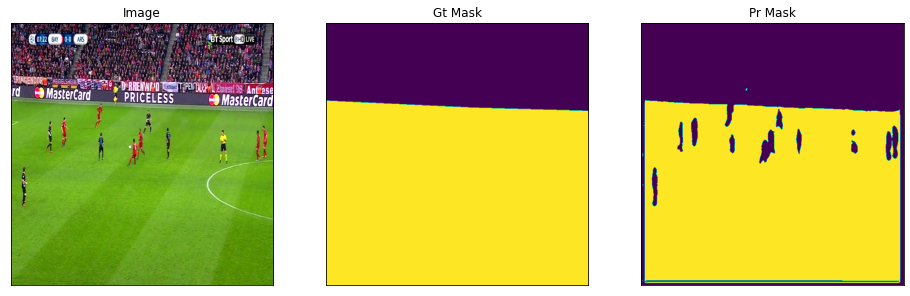

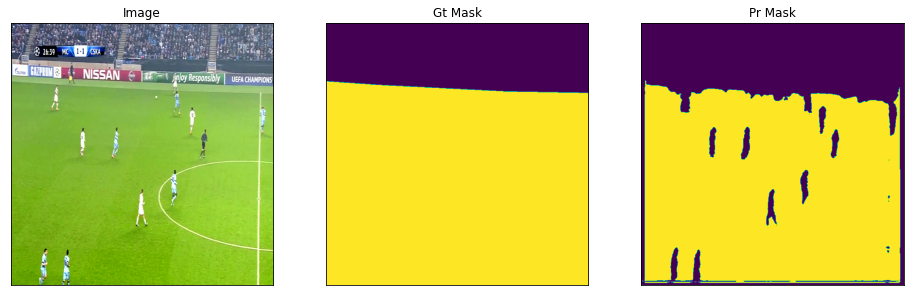

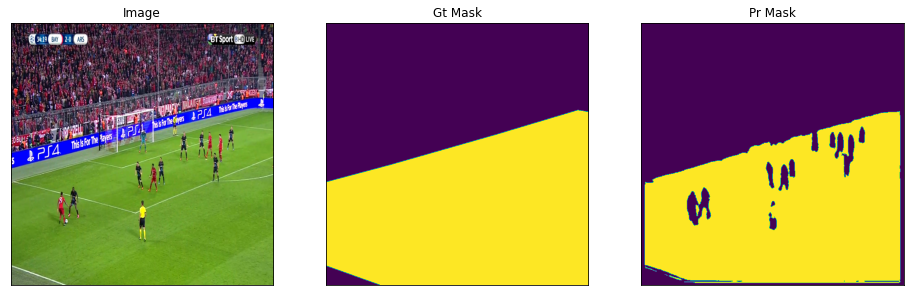

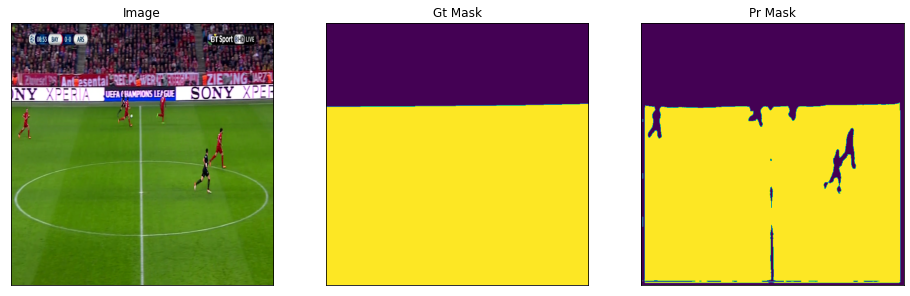

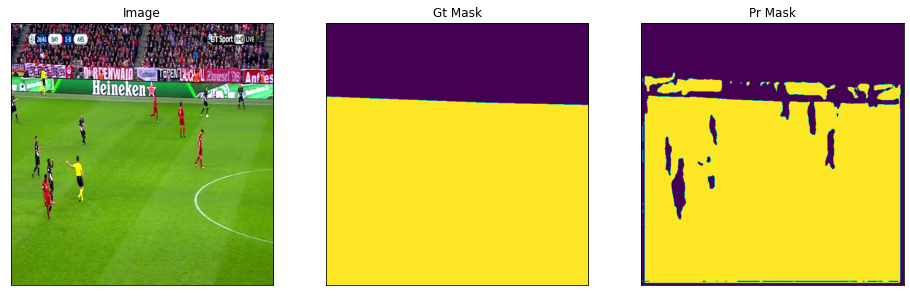

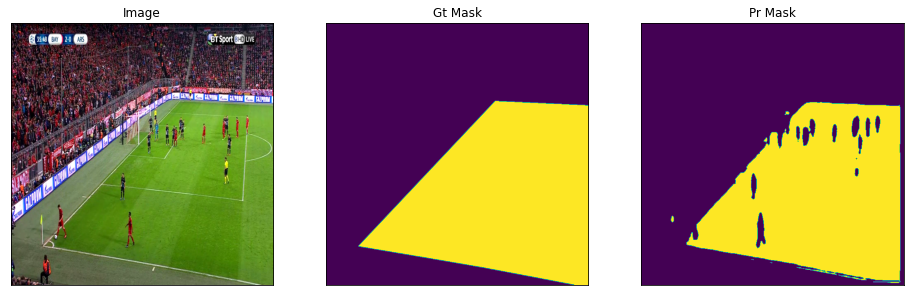

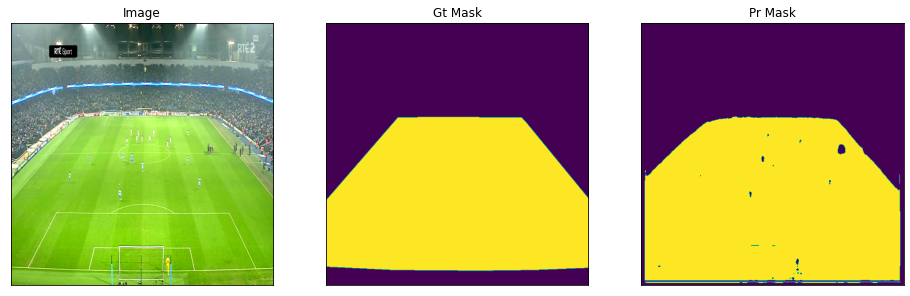

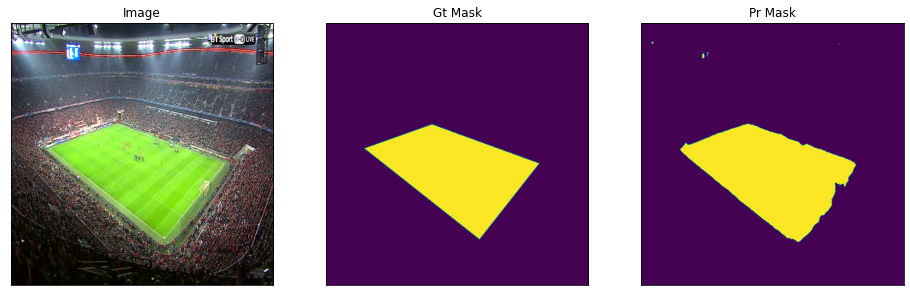

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(160,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(save=False,
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

# Models with TCE

In [ ]:
BATCH_SIZE = 10

In [ ]:
def TCE(y_true, y_pred, smooth = 10):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)

    intersection = K.sum(y_true_f * y_pred_f)
    term_true = K.sum(y_true_f)
    term_pred = K.sum(y_pred_f)
    union = term_true + term_pred - intersection
    dice = (2*intersection + smooth) / (union + intersection + smooth)
    return -K.log(dice)-K.sum(y_true_f * K.log(y_pred_f))

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.Precision(), tf.keras.metrics.Accuracy()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    #tf.debugging.set_log_device_placement(True)

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        total_loss = TCE
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640,640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_VGG_TCE_b10_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=20,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
167/167 [==============================] - 427s 3s/step - loss: 135298.3281 - iou_score: 0.2452 - f1-score: 0.3929 - false_negatives_2: 15743311.0000 - false_positives_2: 72981272.0000 - true_negatives_2: 228058288.0000 - true_positives_2: 367249056.0000 - val_loss: 113213.1016 - val_iou_score: 0.0215 - val_f1-score: 0.0420 - val_false_negatives_2: 44286320.0000 - val_false_positives_2: 999933.0000 - val_true_negatives_2: 14628133.0000 - val_true_positives_2: 1116015.0000
Epoch 2/50
167/167 [==============================] - 423s 3s/step - loss: 36514.2148 - iou_score: 0.2377 - f1-score: 0.3834 - false_negatives_2: 4192787.0000 - false_positives_2: 91456816.0000 - true_negatives_2: 214757632.0000 - true_positives_2: 373624928.0000 - val_loss: 31752.8867 - val_iou_score: 0.2222 - val_f1-score: 0.3607 - val_false_negatives_2: 342208.0000 - val_false_positives_2: 15185751.0000 - val_true_negatives_2: 442315.0000 - val_true_positives_2: 45060124.0000
Epoch 3/50
167/167 [========

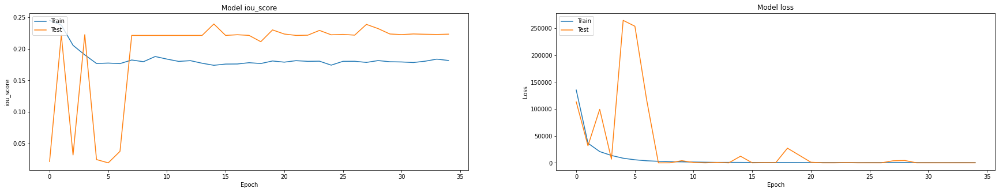

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)

In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_VGG_TCE_b10_IOU0.2395.h5')

In [ ]:
scores = model.evaluate_generator(test_dataloader)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


In [ ]:
print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print(": {:.5}".format(value))

Loss: 6790.3
: 0.24162
: 0.38681
: 6.4833e+05
: 9.9267e+06
: 1.0177e+07
: 4.847e+07


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 6790.3
IOU:0.24162
F1 Score:0.38681
FN:648328.0
FP:9926702.0
TN:10176877.0
TP:48470496.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.50622


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'SP:{Sensitivity:.5}')

SP:0.9868


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)

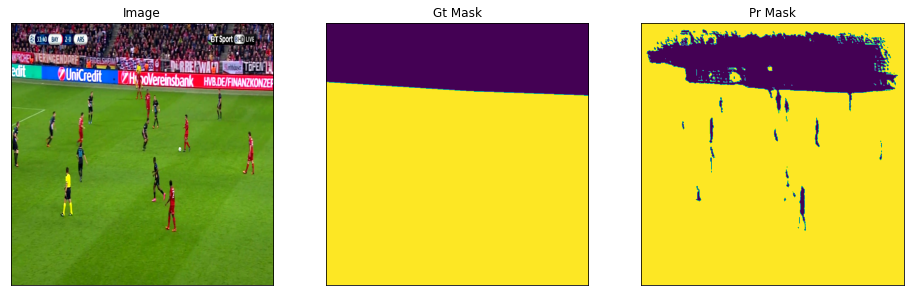

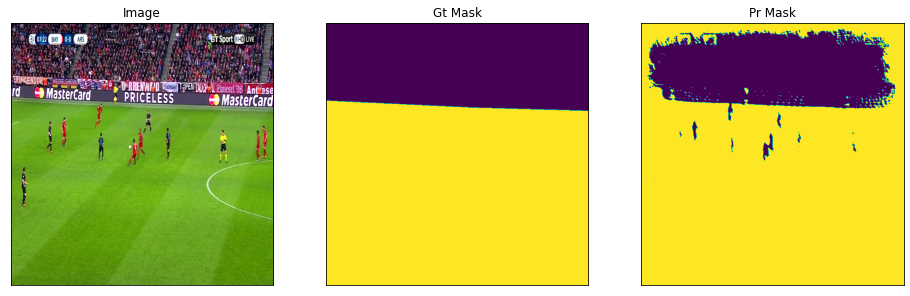

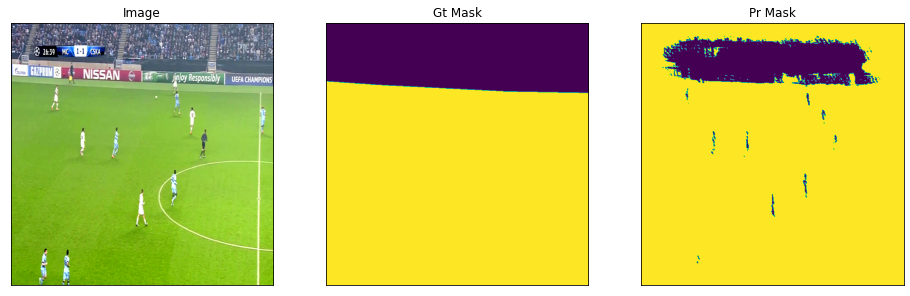

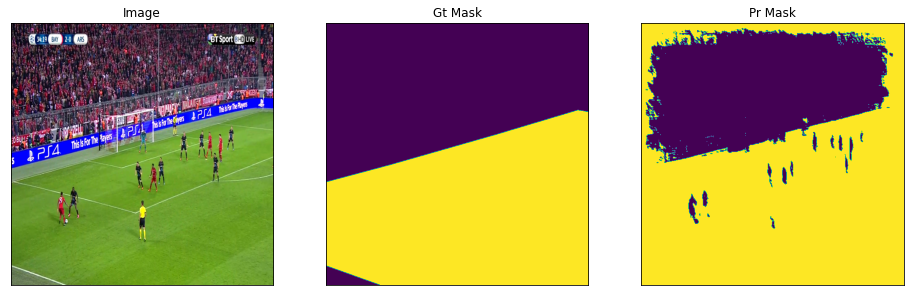

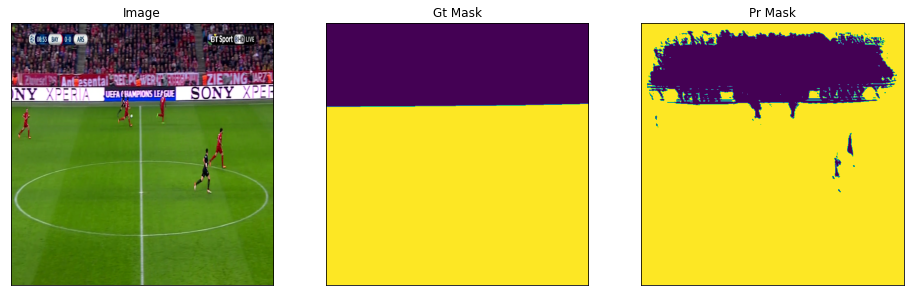

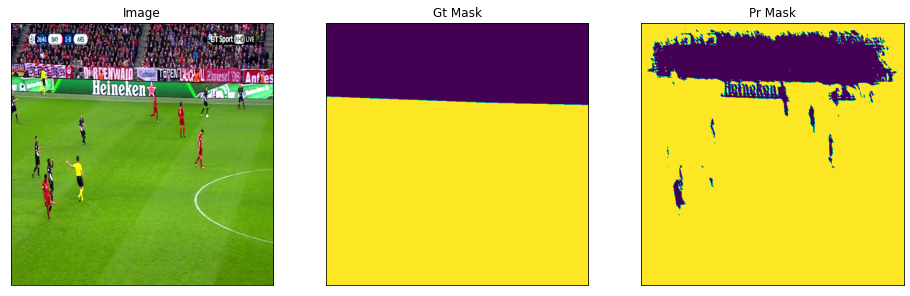

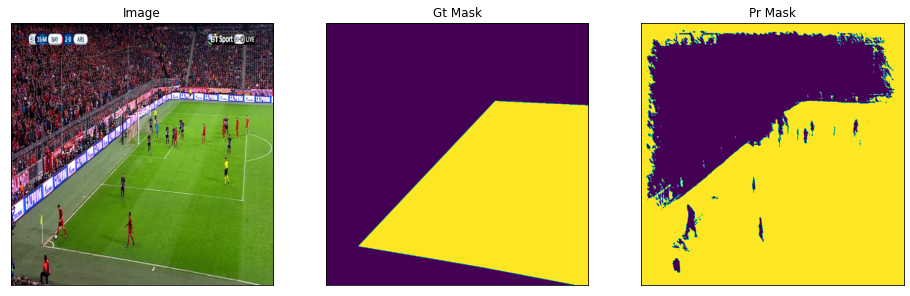

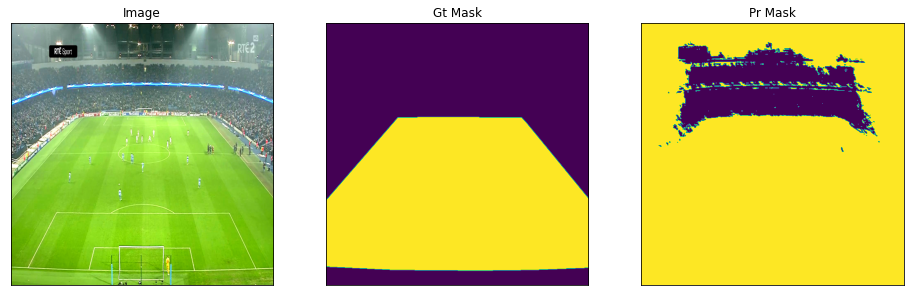

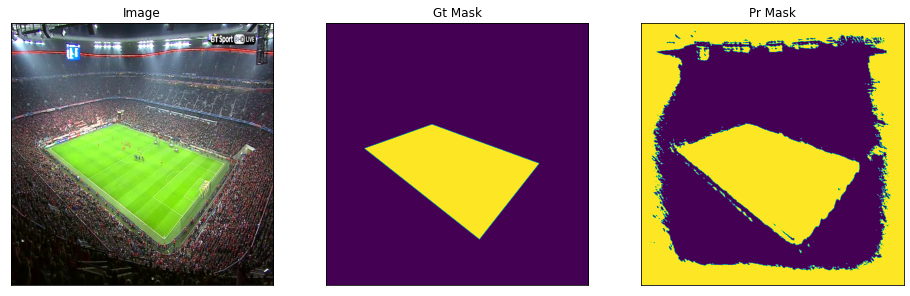

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(160,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )

In [ ]:
BATCH_SIZE = 12

In [ ]:
# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 
use_tpu = False
if use_tpu:
    # Create distribution strategy
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)

    # Create model on TPU:
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        dice_loss = sm.losses.DiceLoss()
        #focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
        #total_loss = dice_loss + (1 * focal_loss)
        total_loss = dice_loss 
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.Precision(), tf.keras.metrics.Accuracy()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

use_gpu = True
if use_gpu == True:

    #tf.debugging.set_log_device_placement(True)

    strategy = tf.distribute.MirroredStrategy()
    with strategy.scope():
        #create model
        model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
        # define optomizer
        optim = keras.optimizers.Adam(LR)
        # Segmentation models losses can be combined together by '+' and scaled by integer or float factor
        total_loss = TCE
        metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.FalseNegatives(), 
                   tf.keras.metrics.FalsePositives(), tf.keras.metrics.TrueNegatives(), tf.keras.metrics.TruePositives()]

        # compile keras model with defined optimozer, loss and metrics
        model.compile(optim, total_loss, metrics)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)


In [ ]:
# Dataset for train images
train_dataset = Dataset(
    x_train_dir, 
    y_train_dir, 
    classes=CLASSES, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

# Dataset for validation images
valid_dataset = Dataset(
    x_valid_dir, 
    y_valid_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = Dataloder(valid_dataset, batch_size=1, shuffle=False)

# check shapes for errors
assert train_dataloader[0][0].shape == (BATCH_SIZE, 640, 640, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, 640,640)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(DATA_DIR+'Models/best_model_tf_VGG_TCE_b12_IOU{val_iou_score:.4f}.h5', save_weights_only=True, monitor='val_iou_score', save_best_only=True, mode='max'),
    keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, mode='min'),
    keras.callbacks.EarlyStopping(monitor='val_iou_score', min_delta=0, patience=20,mode='max', baseline=None, restore_best_weights=False),
]

In [ ]:
# train model
history = model.fit(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader),
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
)

Epoch 1/50
139/139 [==============================] - 430s 3s/step - loss: 232083.1250 - iou_score: 0.2528 - f1-score: 0.4026 - false_negatives_3: 28385656.0000 - false_positives_3: 49583360.0000 - true_negatives_3: 257811136.0000 - true_positives_3: 347432736.0000 - val_loss: 141563.9688 - val_iou_score: 0.0269 - val_f1-score: 0.0523 - val_false_negatives_3: 44023536.0000 - val_false_positives_3: 702706.0000 - val_true_negatives_3: 14925360.0000 - val_true_positives_3: 1378805.0000
Epoch 2/50
139/139 [==============================] - 424s 3s/step - loss: 79801.4453 - iou_score: 0.2476 - f1-score: 0.3966 - false_negatives_3: 5010290.0000 - false_positives_3: 71937584.0000 - true_negatives_3: 234941168.0000 - true_positives_3: 371323744.0000 - val_loss: 85058.1172 - val_iou_score: 0.0315 - val_f1-score: 0.0610 - val_false_negatives_3: 43700172.0000 - val_false_positives_3: 1149285.0000 - val_true_negatives_3: 14478781.0000 - val_true_positives_3: 1702158.0000
Epoch 3/50
139/139 [======

In [ ]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [ ]:
test_dataset = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES, 
    augmentation=get_validation_augmentation(),
    preprocessing=get_preprocessing(preprocess_input),
)

test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)



In [ ]:
# load best weights
model.load_weights(DATA_DIR+'Models/VGG_models/best_model_tf_VGG_TCE_b12_IOU0.2490.h5')

In [ ]:
scores = model.evaluate_generator(test_dataloader)

print("Loss: {:.5}".format(scores[0]))
for metric, value in zip(metrics, scores[1:]):
    print(": {:.5}".format(value))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1973: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  warnings.warn('`Model.evaluate_generator` is deprecated and '


Loss: 3016.2
: 0.25315
: 0.40148
: 5.7447e+05
: 7.7201e+06
: 1.2384e+07
: 4.8544e+07


In [ ]:
print("Loss: {:.5}".format(scores[0]))
print(F'IOU:{scores[1]:.5}')
print(F'F1 Score:{scores[2]:.5}')
print(F'FN:{scores[3]}')
print(F'FP:{scores[4]}')
print(F'TN:{scores[5]}')
print(F'TP:{scores[6]}')

Loss: 3016.2
IOU:0.25315
F1 Score:0.40148
FN:574469.0
FP:7720067.0
TN:12383512.0
TP:48544376.0


In [ ]:
sp = scores[5]/(scores[5]+scores[4])
print(F'SP:{sp:.5}')

SP:0.61599


In [ ]:
Sensitivity = scores[6]/(scores[6]+scores[3])
print(F'SP:{Sensitivity:.5}')


SP:0.9883


In [ ]:
test_dataset_vis = Dataset(
    x_test_dir, 
    y_test_dir, 
    classes=CLASSES,
)


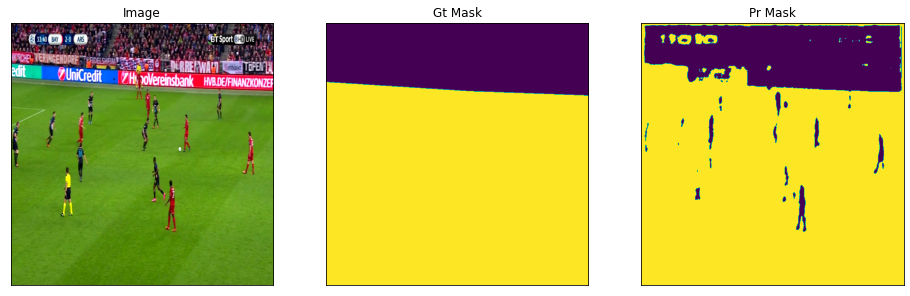

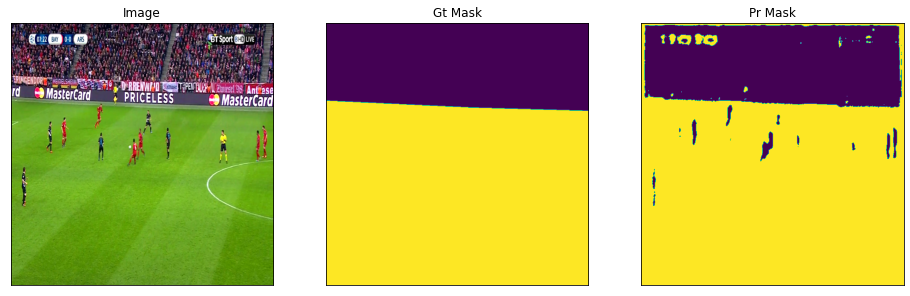

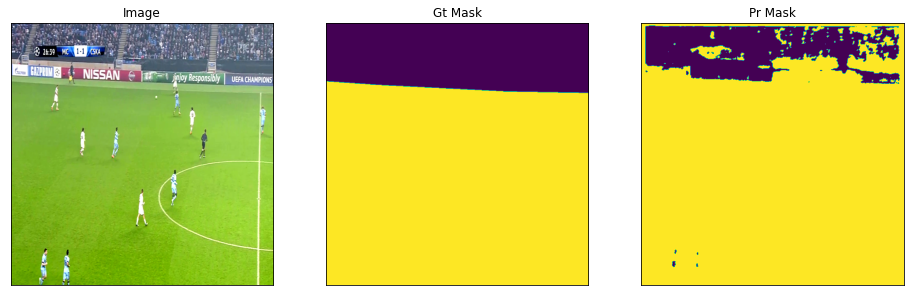

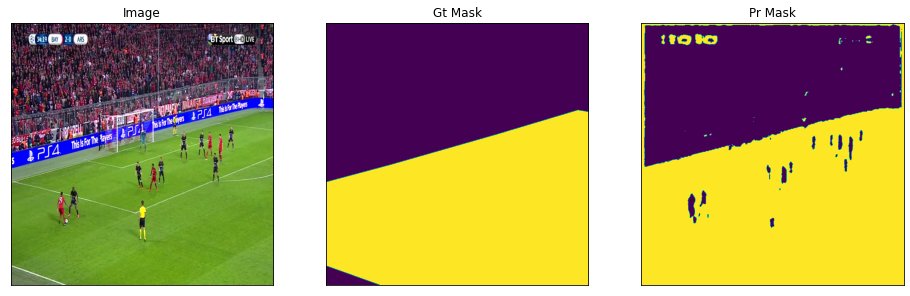

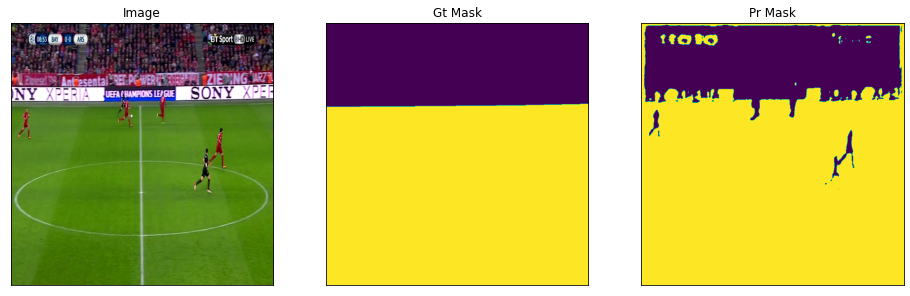

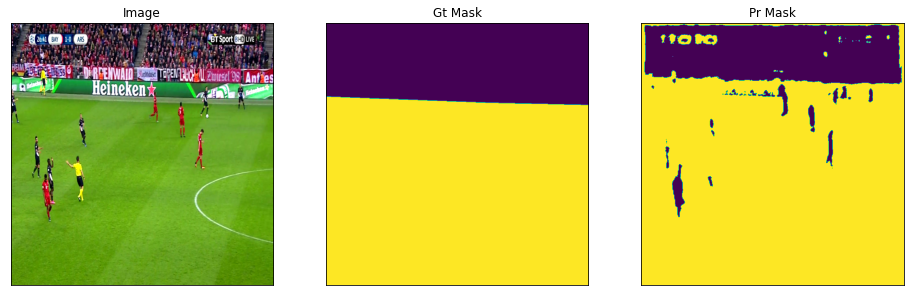

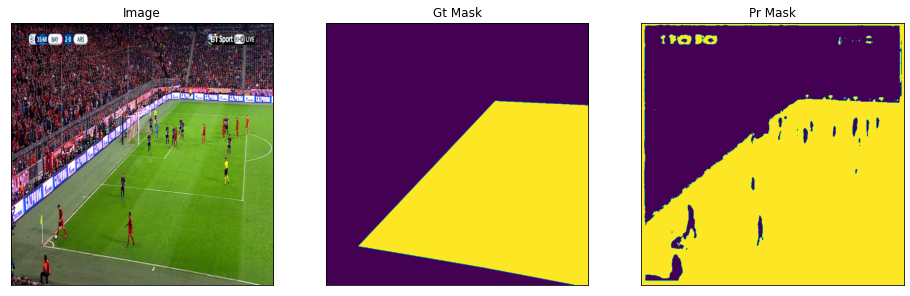

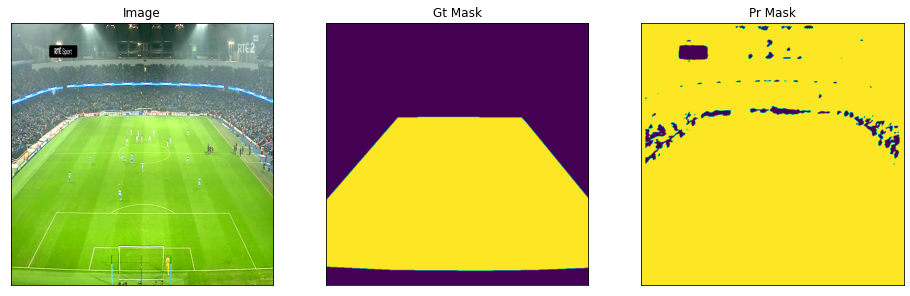

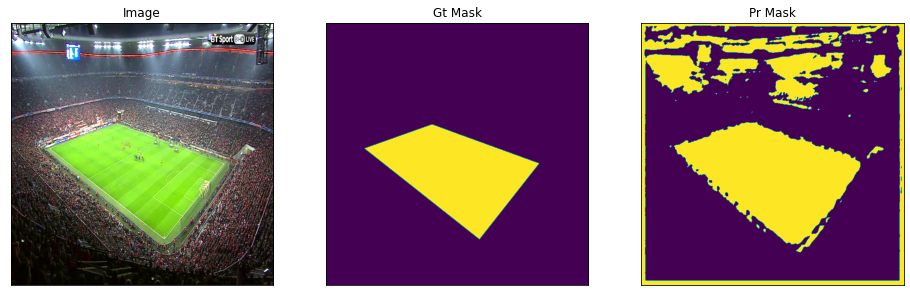

In [ ]:
n = 5
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(160,169):
    
    image, gt_mask = test_dataset[i]
    image_gt, _ = test_dataset_vis[i]
    image = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image).round()
    
    visualize(save=False,
        image=denormalize(image_gt.squeeze()),
        gt_mask=gt_mask.squeeze(),
        pr_mask=pr_mask.squeeze(),
    )